# Методы прогнозирования стационарных временных рядов <a class="tocSkip">

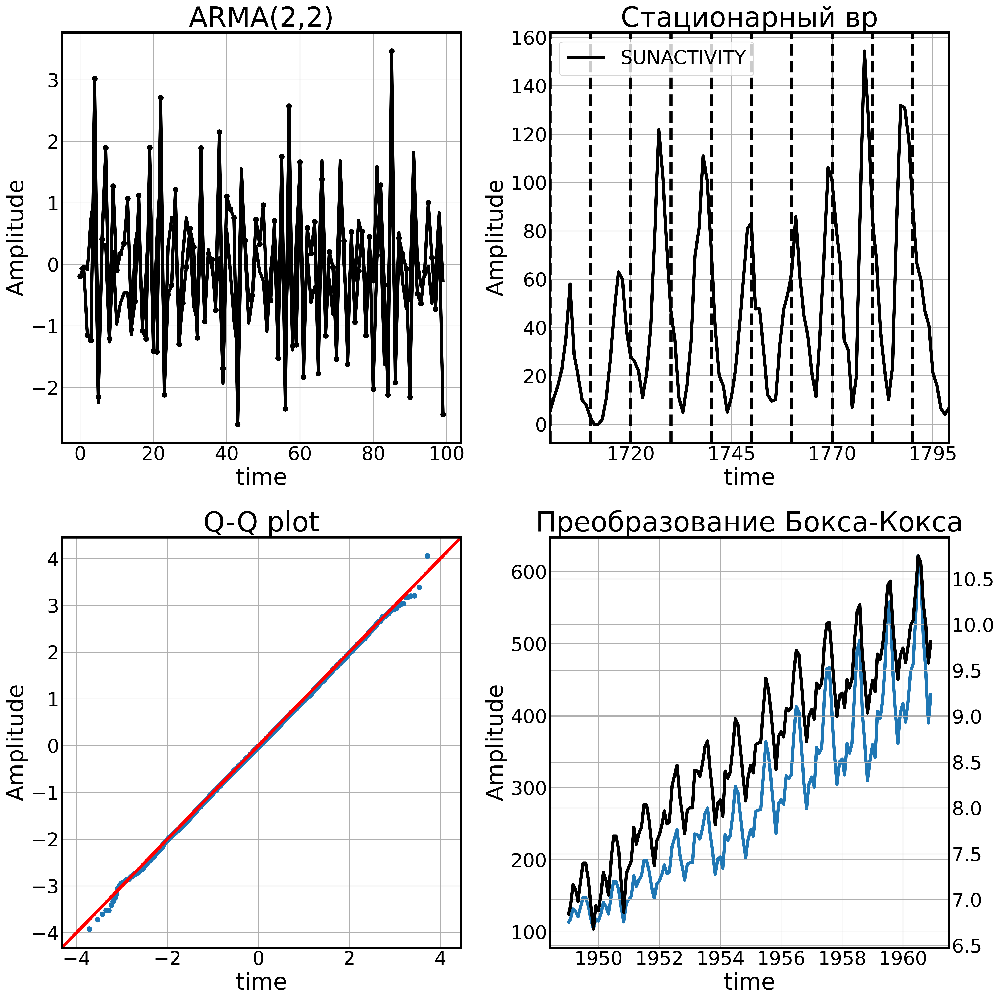

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
import statsmodels.api as sm
from scipy import stats
from statsmodels.graphics import tsaplots
from sktime.utils.plotting import plot_correlations
from itertools import product

In [2]:
params = {'lines.linewidth': 4,
          'lines.solid_capstyle': 'butt',
          'axes.labelsize': 'large',
          'axes.axisbelow': True,
          'axes.grid': True,
          'axes.linewidth': 3.0,
          'axes.titlesize': 'x-large',
          'grid.linestyle': '-',
          'grid.linewidth': 1.0,
          'xtick.major.size': 0,
          'xtick.minor.size': 0,
          'ytick.major.size': 0,
          'ytick.minor.size': 0,
          'figure.subplot.left': 0.08,
          'figure.subplot.right': 0.95,
          'figure.subplot.bottom': 0.07,
          'figure.figsize': (10.8, 7.8),
          'figure.autolayout': True,
          'figure.dpi': 300,
          'font.size': 24.0 }
plt.rcParams.update(params)

In [3]:
pd.options.display.max_rows = 999
%cd ..
%env PYTHONPATH=.

/home/dssaburi/projects/teta
env: PYTHONPATH=.


# Статистические свойства моделей AR и MA

Здесь мы убедимся в наличии у моделей AR и MA тех свойств, которые обсуждали в лекции

## AR 1

Рассмотрим AR 1 с коэффициентом 0.9

In [5]:
ar1_model = sm.tsa.ArmaProcess(ar=[1, -0.9,],nobs=1000)
ar1_ts = pd.Series(ar1_model.generate_sample())

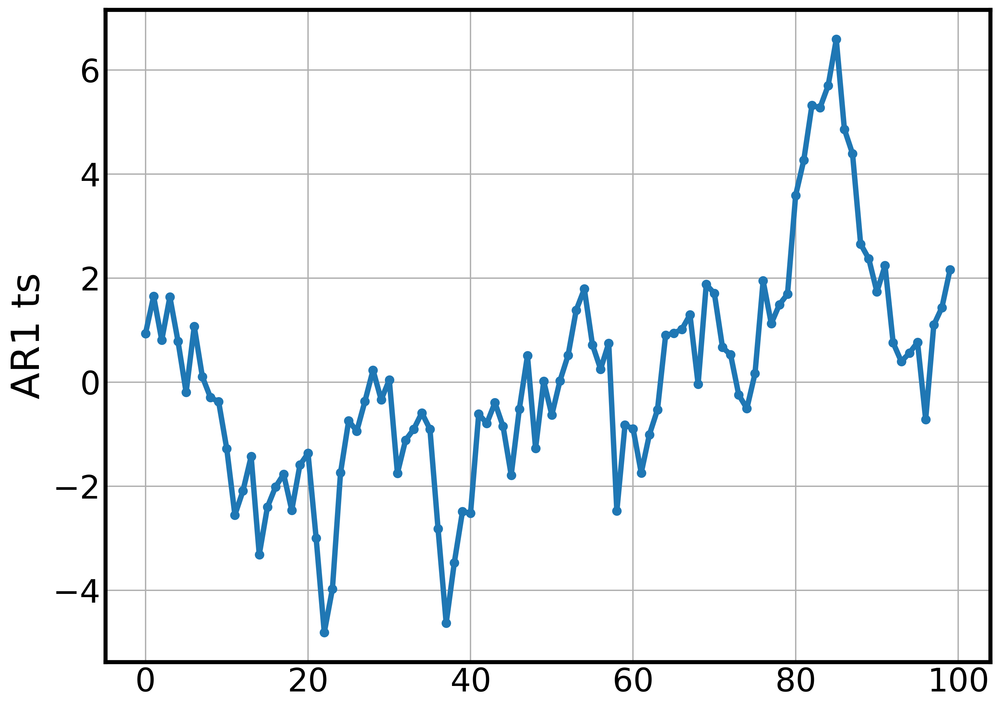

In [6]:
ax = ar1_ts.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

Стационарность и обратимость

In [7]:
ar1_model.isinvertible,ar1_model.isstationary

(True, True)

In [8]:
ar1_ts.mean(),ar1_ts.std()

(0.08597981274625416, 2.1436807380423795)

АКФ AR(1) экспоненциально убывает, ЧАКФ обнуляется после первого лага

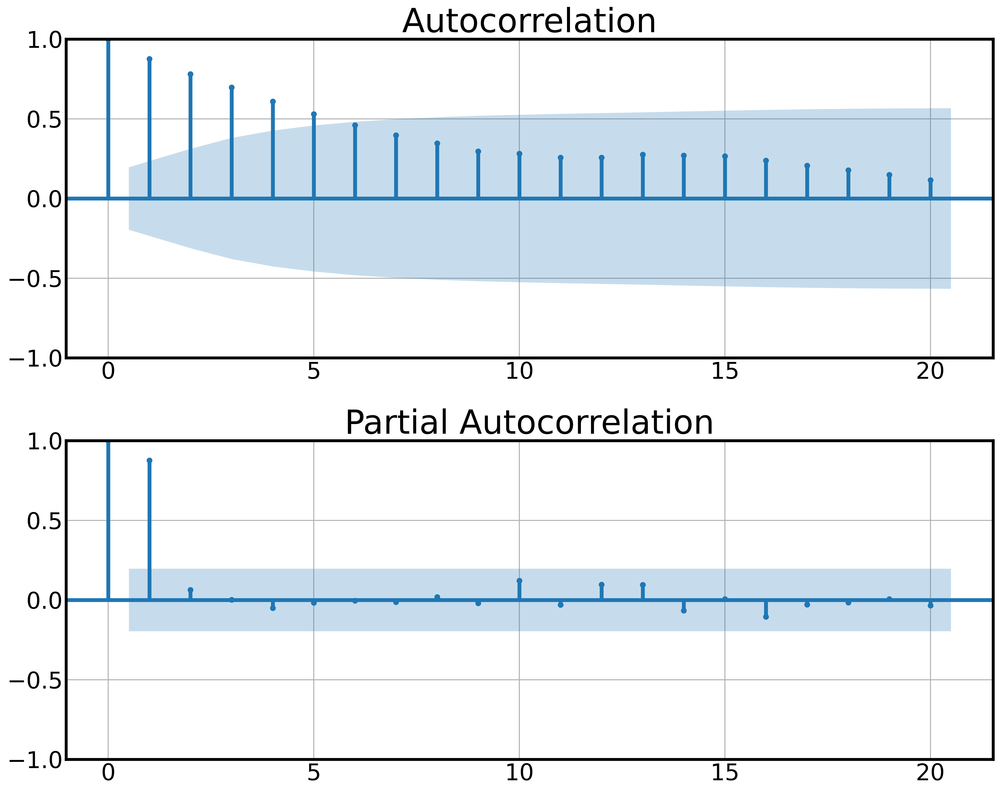

In [9]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ar1_ts,ax=ax[0]);
tsaplots.plot_pacf(ar1_ts,ax=ax[1]);

Рассмотрим AR 1 с коэффициентом -0.9

In [10]:
ar1_model = sm.tsa.ArmaProcess(ar=[1, 0.9,],nobs=1000)
ar1_ts = pd.Series(ar1_model.generate_sample())

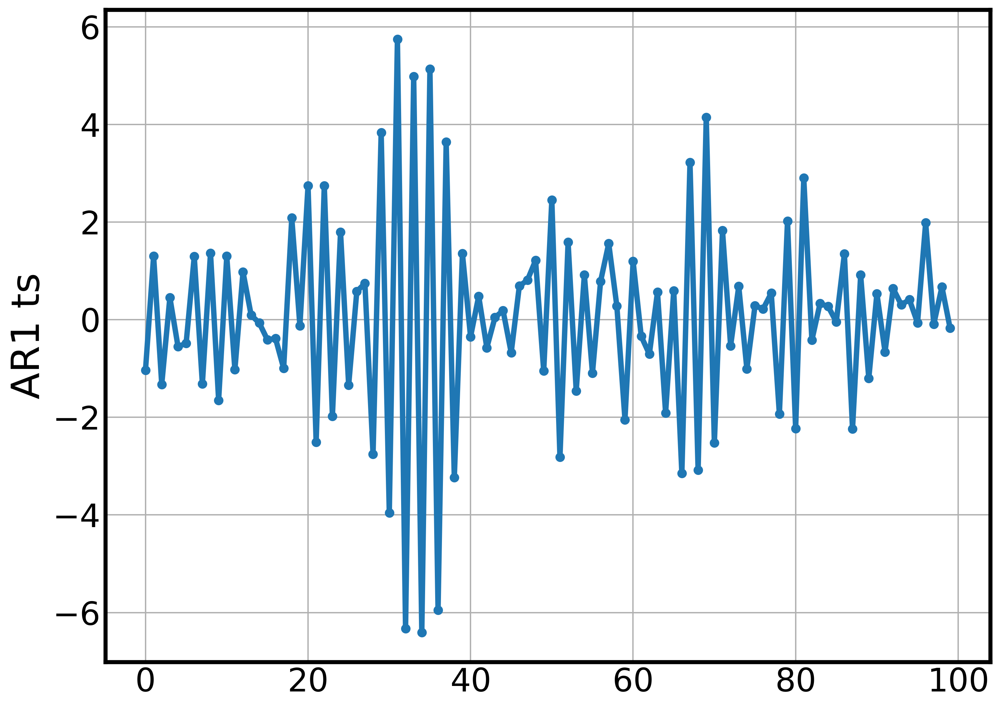

In [11]:
ax = ar1_ts.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

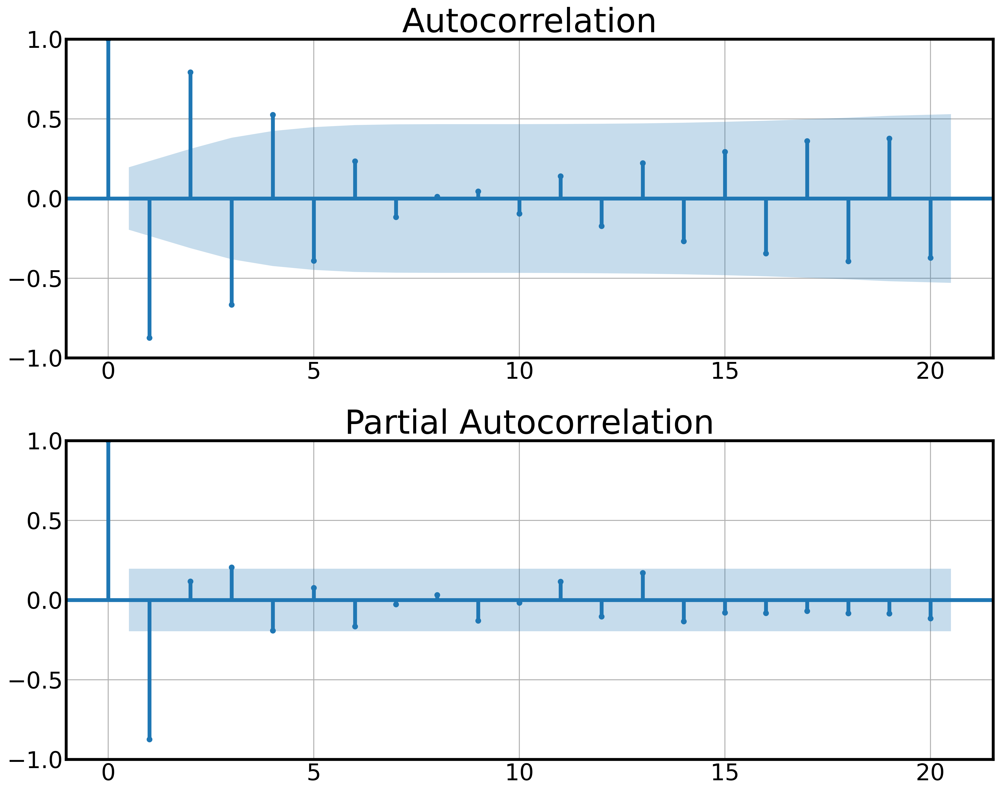

In [12]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ar1_ts,ax=ax[0]);
tsaplots.plot_pacf(ar1_ts,ax=ax[1]);

## AR 2

In [13]:
ar2_model = sm.tsa.ArmaProcess(ar=[1, -0.9,0.8],nobs=1000)
ar2_ts = pd.Series(ar2_model.generate_sample())

In [14]:
ar2_model.isinvertible,ar2_model.isstationary

(True, True)

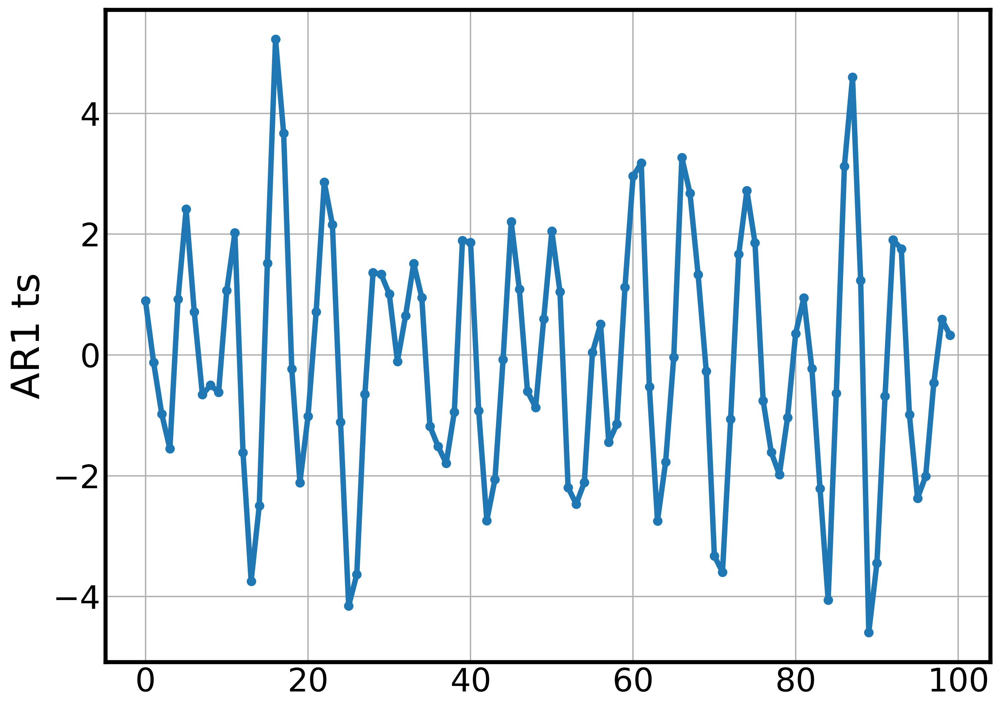

In [15]:
ax = ar2_ts.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

Корни модели AR 2 получилось комплексными, но их амплитуда - больше 1

In [16]:
ar2_model.arroots

array([0.5625-0.96622655j, 0.5625+0.96622655j])

In [17]:
0.96622655**2+0.5625**2

1.2499999959249024

In [18]:
ar1_ts.mean(),ar1_ts.std()

(0.02522199704986814, 2.1380170323763337)

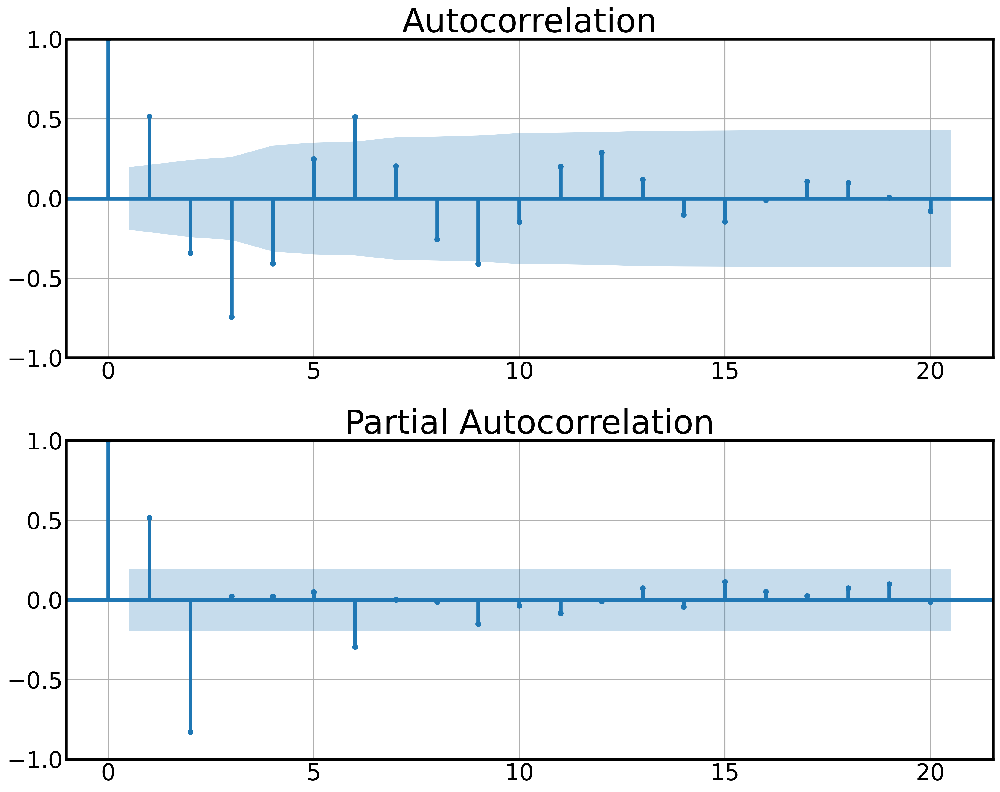

In [19]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ar2_ts,ax=ax[0]);
tsaplots.plot_pacf(ar2_ts,ax=ax[1]);

Проверим обратимость модели AR 2 - возьмем первые 10 лагов её обращенной формы создадим модель МА(10) 

In [20]:
ma_mod = ar2_model.arma2ma(lags=10)

In [21]:
ma_mod

array([ 1.        ,  0.9       ,  0.01      , -0.711     , -0.6479    ,
       -0.01431   ,  0.505441  ,  0.4663449 ,  0.01535761, -0.35925407])

In [22]:
ma_mod =  sm.tsa.ArmaProcess(ma=ma_mod,nobs=10000)
ar2_ts_ma = pd.Series(ma_mod.generate_sample())

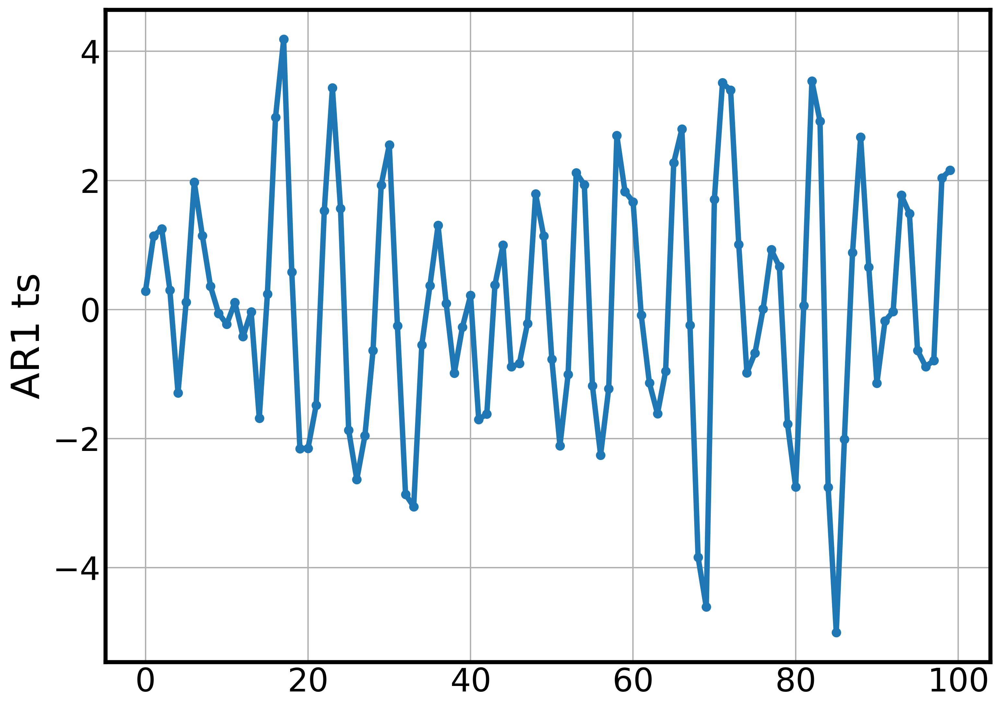

In [23]:
ax = ar2_ts_ma.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

Обратите внимание, что не смотря на то, что мы изучаем ряд модели МА(10), который мы перегенерировали заново, акф и чакф по прежнему подсказывают нам наличие AR(2)

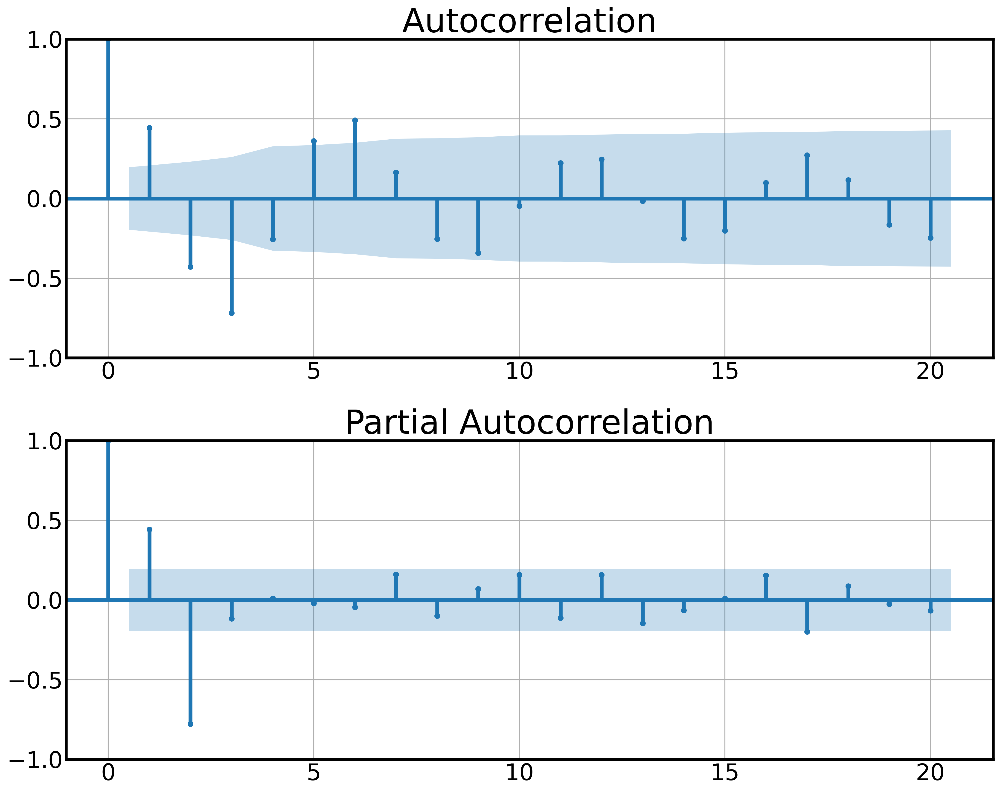

In [24]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ar2_ts_ma,ax=ax[0]);
tsaplots.plot_pacf(ar2_ts_ma,ax=ax[1]);

Посмотрим, что будет происходить с обратимость при нестационарной AR-части

In [25]:
ar2_model = sm.tsa.ArmaProcess(ar=[1, 0.9,-0.15],nobs=10000)
ar2_ts = pd.Series(ar2_model.generate_sample())

In [26]:
ar2_model.isinvertible,ar2_model.isstationary

(True, False)

Один из корней меньше 1 - модель нестационарна

In [27]:
ar2_model.arroots

array([-0.95811403,  6.95811403])

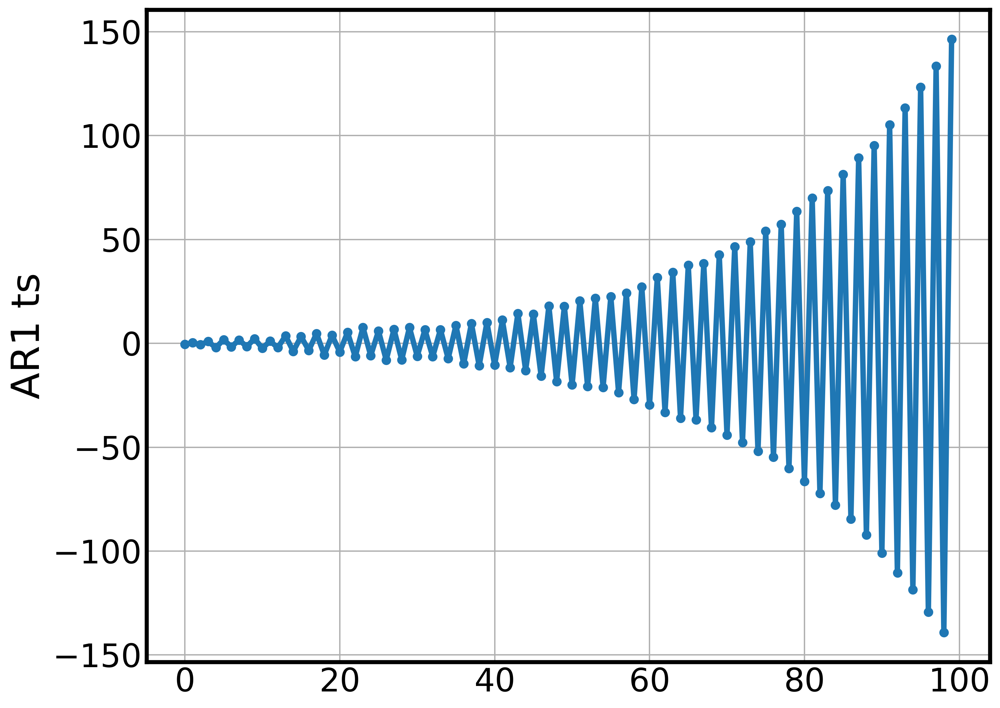

In [28]:
ax = ar2_ts.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

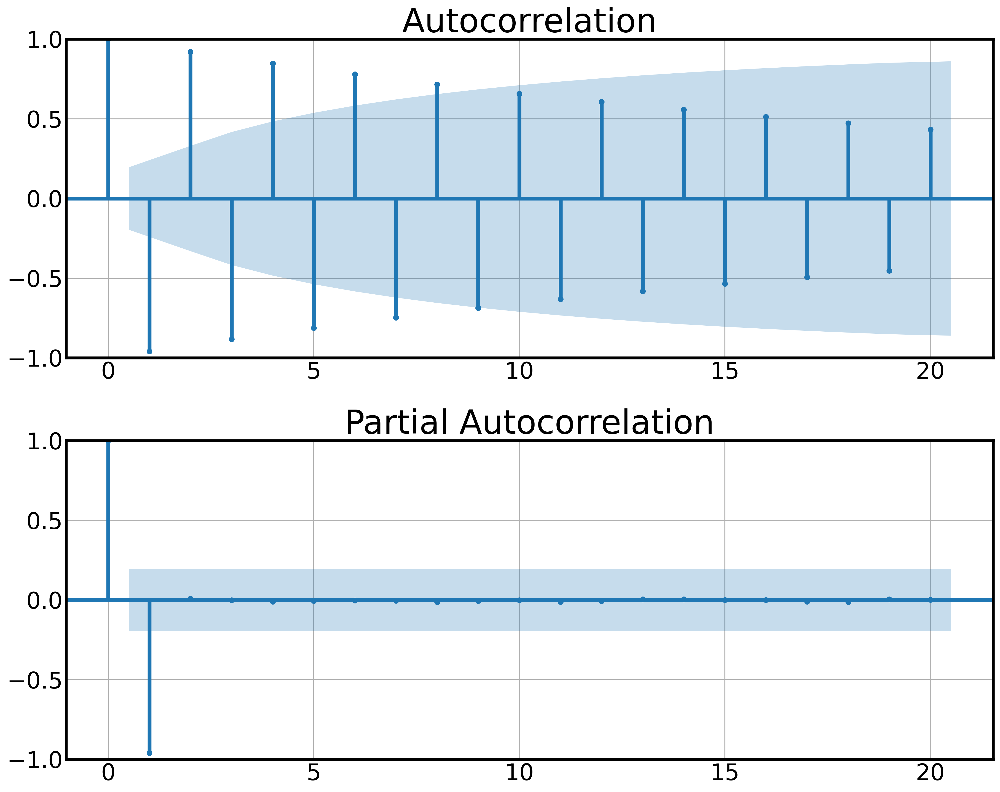

In [29]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ar2_ts,ax=ax[0]);
tsaplots.plot_pacf(ar2_ts,ax=ax[1]);

Формально мы можем разложить ряд на ма-процесс, но даже визуально видно, что новый сгенерированный ряд сильно отличается от исходного.

In [30]:
ma_mod = ar2_model.arma2ma(lags=10)
ma_mod =  sm.tsa.ArmaProcess(ma=ma_mod,nobs=10000)
ar2_ts_ma = pd.Series(ma_mod.generate_sample())

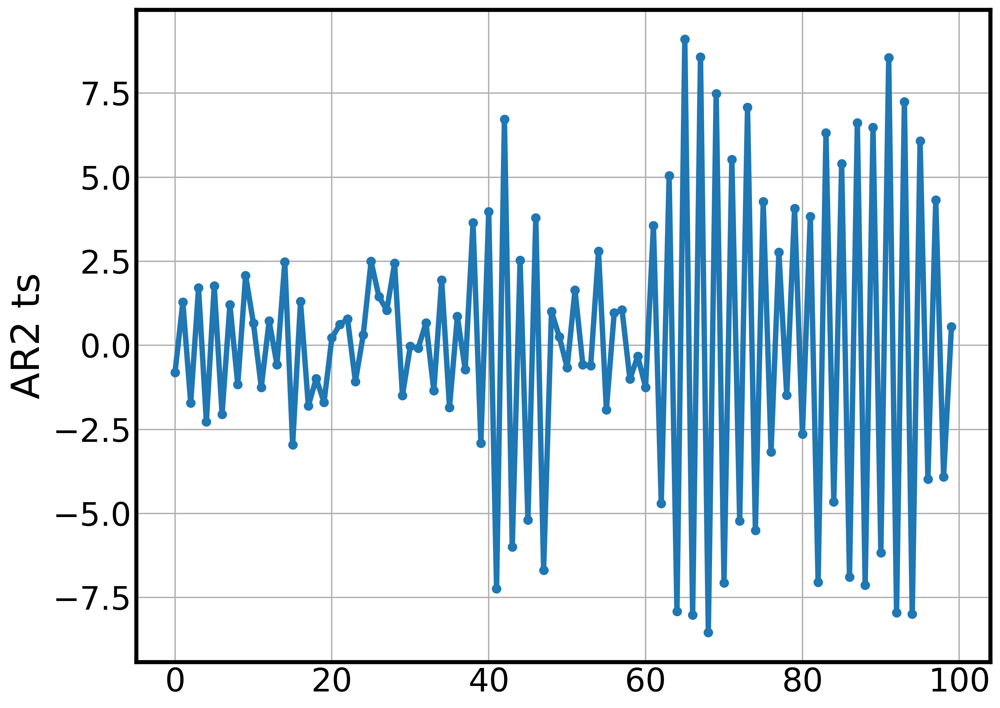

In [31]:
ax = ar2_ts_ma.plot(legend=False,marker='o')
ax.set_ylabel('AR2 ts');

## Модель МА 2

In [32]:
ma3_model = sm.tsa.ArmaProcess(ma=[1, 0.9, 0.8],nobs=1000)
ma3_ts = pd.Series(ma3_model.generate_sample(burnin=5000))

In [33]:
ma3_model.isinvertible,ma3_model.isstationary

(True, True)

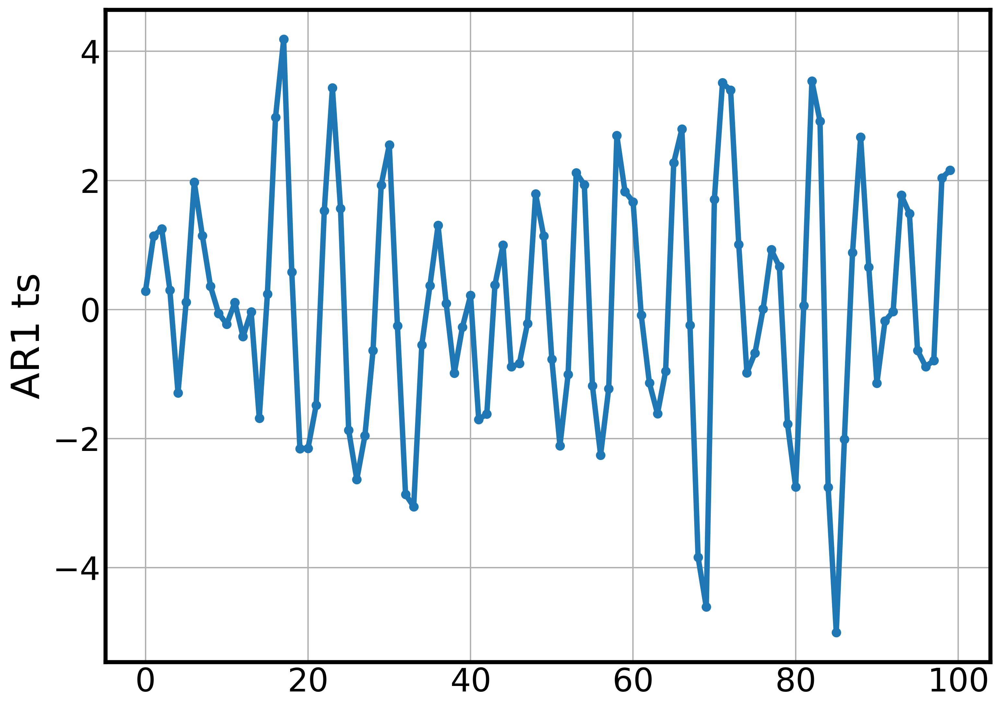

In [23]:
ax = ar2_ts_ma.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

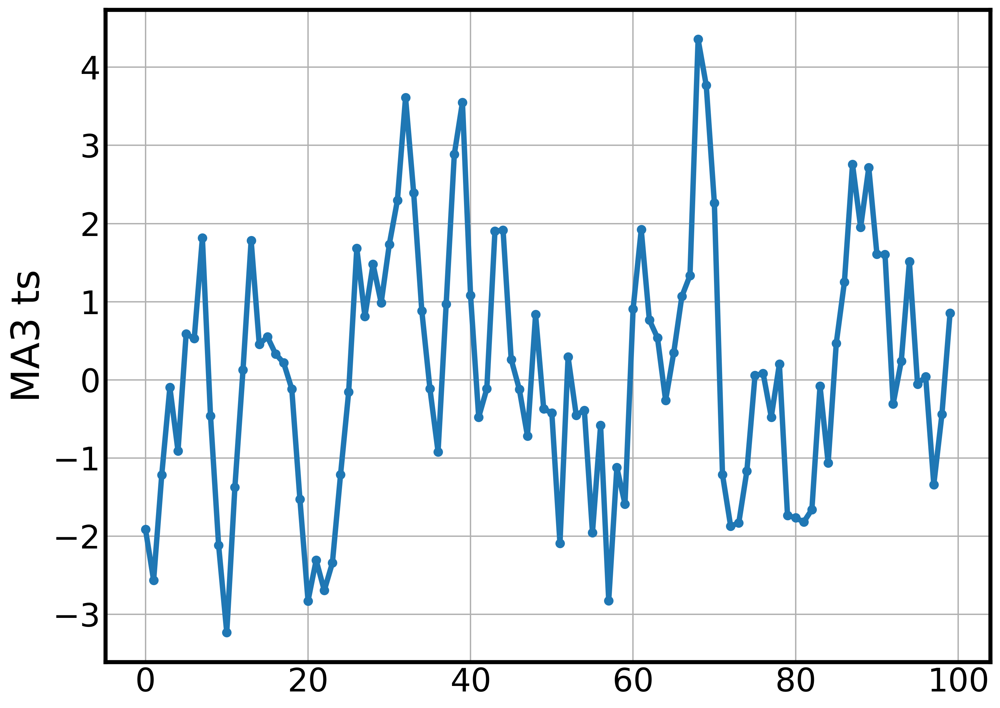

In [34]:
ax = ma3_ts.plot(legend=False,marker='o')
ax.set_ylabel('MA3 ts');

АКФ МА(2) обнуляется после лага 2, ЧАКФ экспоненциально убывает  

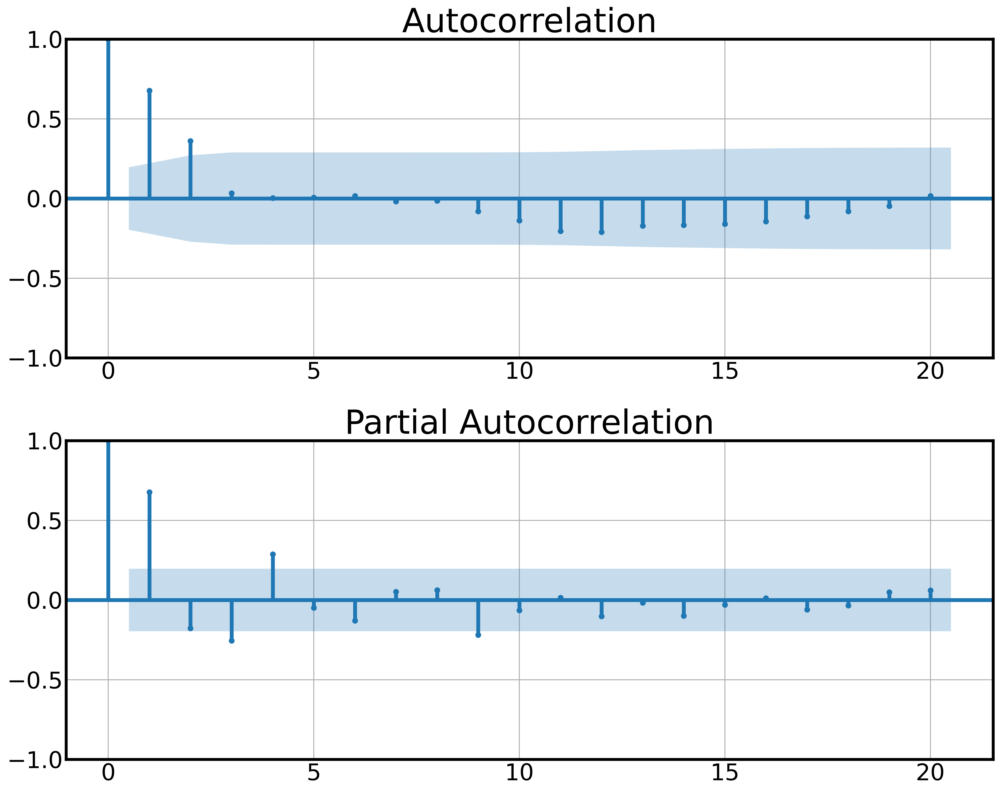

In [35]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ma3_ts,ax=ax[0]);
tsaplots.plot_pacf(ma3_ts,ax=ax[1]);

Убедимся, что сложную МА-модель можно воспроизвести в AR-предствлении

In [36]:
ma3_model = sm.tsa.ArmaProcess(ar=ma3_model.arma2ar(lags = 10),nobs=1000)
ma3_arts = pd.Series(ma3_model.generate_sample(burnin=10000))

In [37]:
ma3_model.isinvertible,ma3_model.isstationary

(True, True)

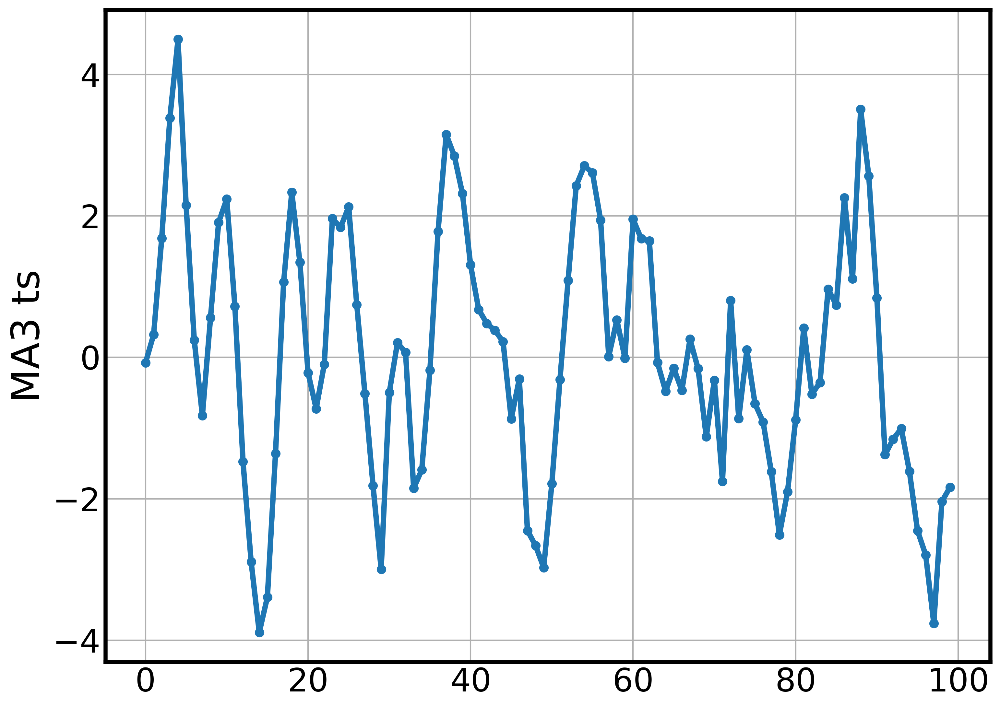

In [38]:
ax = ma3_arts.plot(legend=False,marker='o')
ax.set_ylabel('MA3 ts');

Если МА необратимо, то попытка перейти к AR-представлению может привести к нестационарному вр

In [39]:
ma3_model = sm.tsa.ArmaProcess(ma=[1, -0.9, 0.8,0.8],nobs=1000)
ma3_arts = pd.Series(ma3_model.generate_sample(burnin=10000))

In [40]:
ma3_model.isinvertible,ma3_model.isstationary

(False, True)

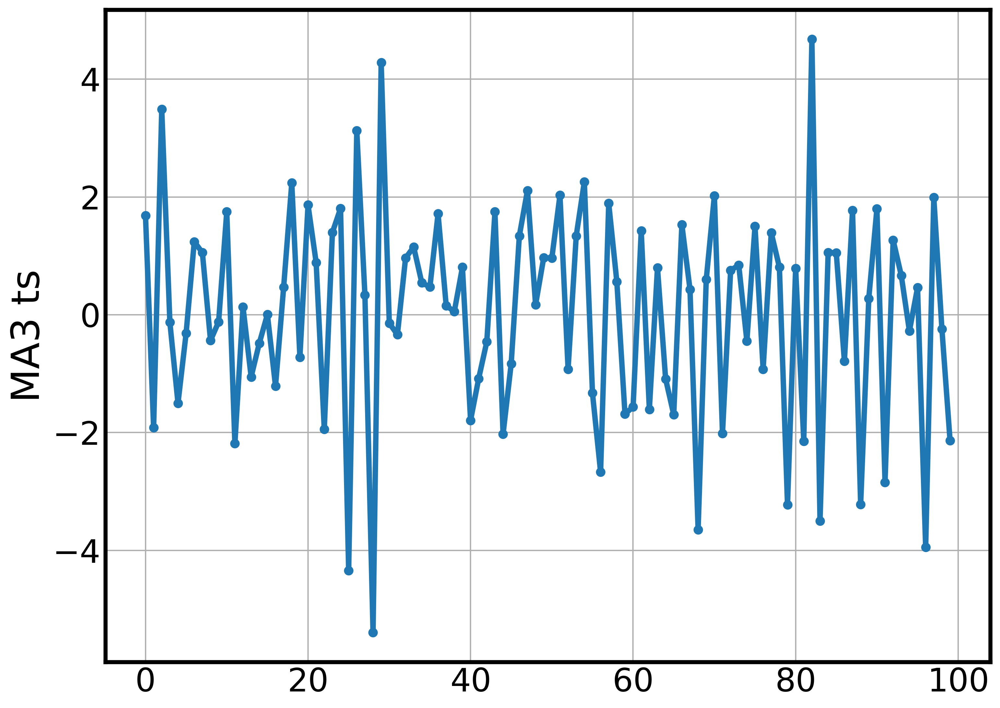

In [41]:
ax = ma3_arts.plot(legend=False,marker='o')
ax.set_ylabel('MA3 ts');

In [42]:
ma3_model.arma2ar(lags = 10)

array([ 1.        ,  0.9       ,  0.01      , -1.511     , -2.0879    ,
       -0.67831   ,  2.268641  ,  4.2547449 ,  2.55700561, -2.91740367])

In [43]:
ma3_ar_model = sm.tsa.ArmaProcess(ar=ma3_model.arma2ar(lags = 10),nobs=1000)
ma3_ar_arts = pd.Series(ma3_ar_model.generate_sample(burnin=10))

In [44]:
ma3_ar_model.isinvertible,ma3_ar_model.isstationary

(True, False)

# Обучение моделей ARMA

## AR 3

In [45]:
ar3_model = sm.tsa.ArmaProcess(ar=[1, -0.9,0.8,-0.8],nobs=1000)
ar3_ts = pd.Series(ar3_model.generate_sample(burnin=10000))

In [46]:
ar3_model.isinvertible,ar3_model.isstationary

(True, True)

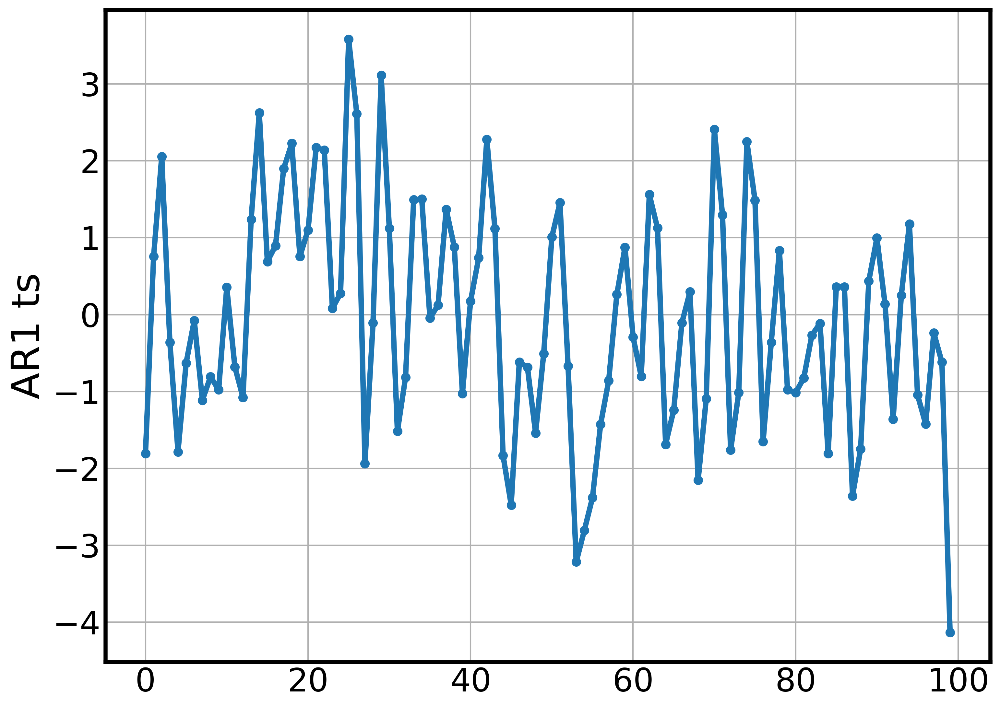

In [47]:
ax = ar3_ts.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

Попробуем обучить более простую модель 

In [48]:
from statsmodels.tsa.arima.model import ARIMA

In [49]:
model = ARIMA(ar3_ts,order = (2,0,0))

model = model.fit()

forecast = model.predict(start=0,end=len(ar3_ts)-1)

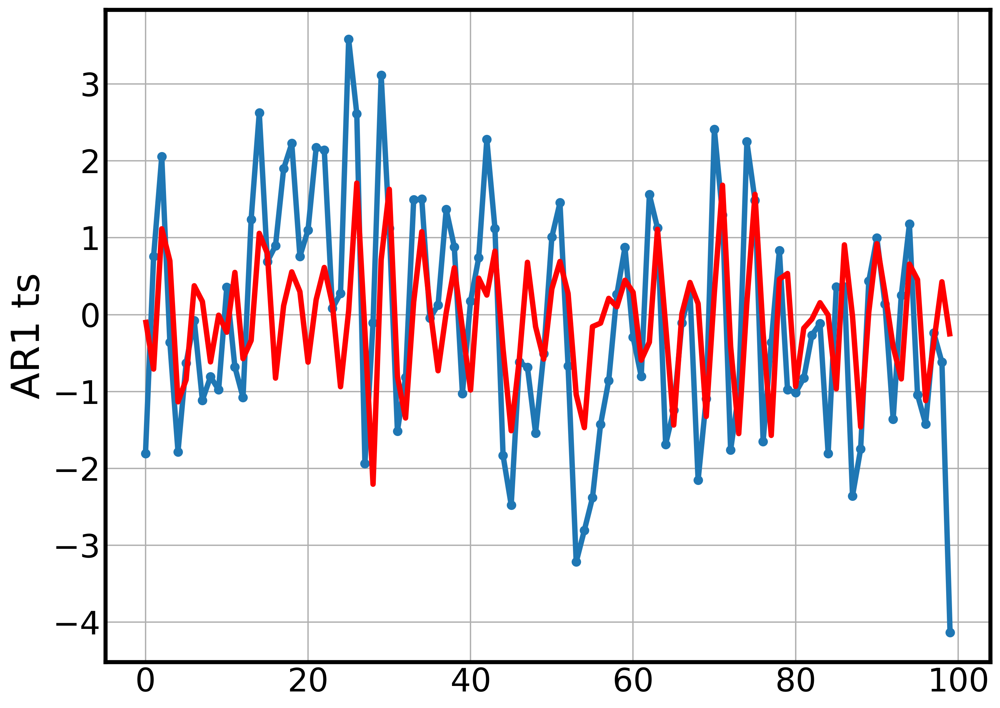

In [50]:
ax = ar3_ts.plot(legend=False,marker='o')
ax.plot(forecast,c='red')
ax.set_ylabel('AR1 ts');

Видно, что в остатках остались зависимость, что подтверждается их АКФ и ЧАКФ

In [51]:
resid = ar3_ts - forecast

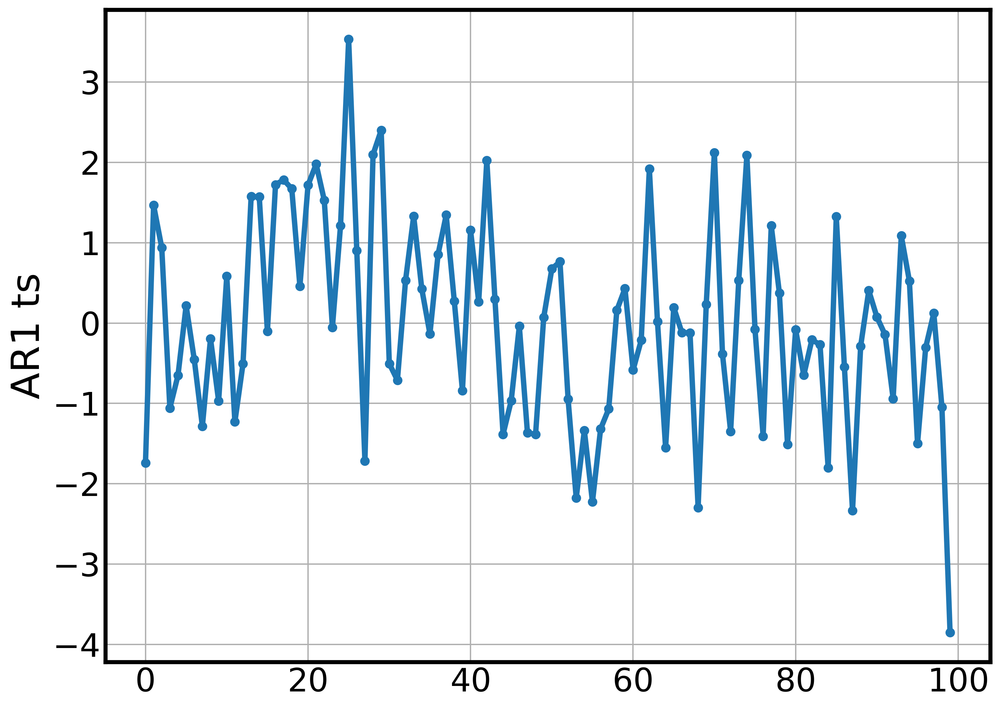

In [52]:
ax = resid.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

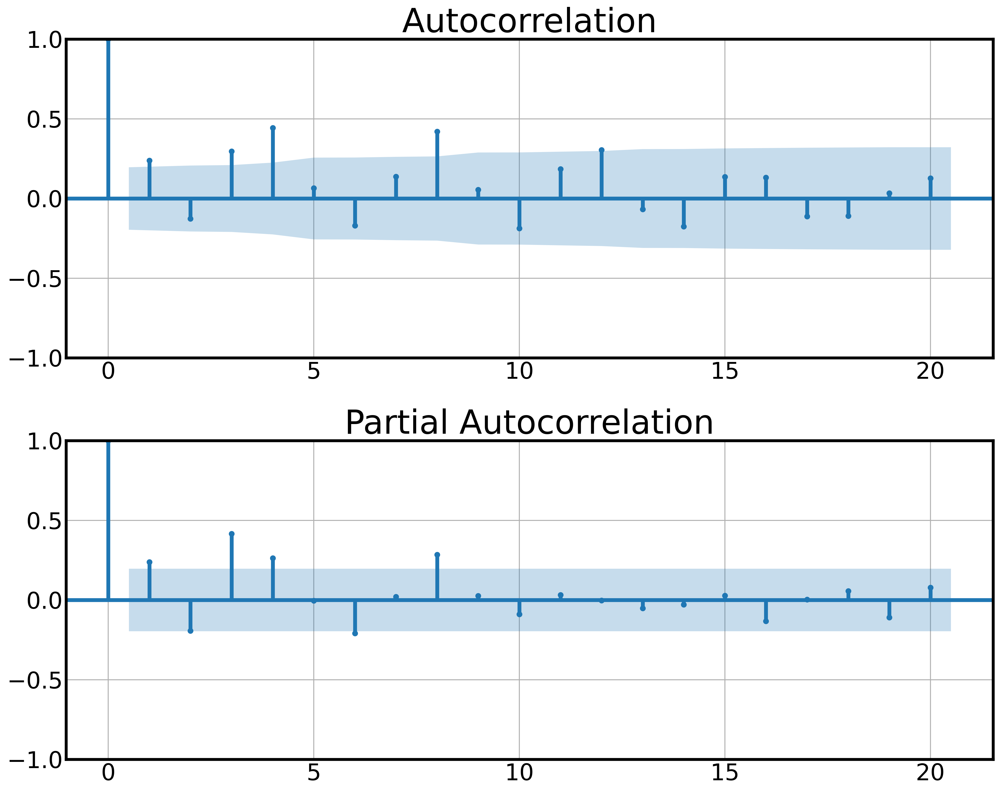

In [53]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(resid,ax=ax[0]);
tsaplots.plot_pacf(resid,ax=ax[1]);

При правильном подборе параметров остатки выглядят как белый шум

In [64]:
model = ARIMA(ar3_ts,order = (3,0,0))

model = model.fit(method = 'statespace')

forecast = model.predict(start=0,end=len(ar3_ts)-1)

In [65]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  100
Model:                 ARIMA(3, 0, 0)   Log Likelihood                -141.737
Date:                Mon, 22 Apr 2024   AIC                            293.473
Time:                        20:55:42   BIC                            306.499
Sample:                             0   HQIC                           298.745
                                - 100                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1385      0.306     -0.453      0.651      -0.738       0.461
ar.L1          0.8007      0.107      7.480      0.000       0.591       1.011
ar.L2         -0.7629      0.097     -7.834      0.000      -0.954      -0.572
ar.L3          0.6410      0.095      6.764      0.000       0.455       0.827
sigma2         0.9758      0.153      6.394      0.000       0.677       1.275
===================================================================================
Ljung-Box (L1) (Q):                   0.15   Jarque-Bera (JB):                 0.35
Prob(Q):                              0.70   Prob(JB):                         0.84
Heteroskedasticity (H):               1.23   Skew:                            -0.14
Prob(H) (two-sided):                  0.55   Kurtosis:                         2.93
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

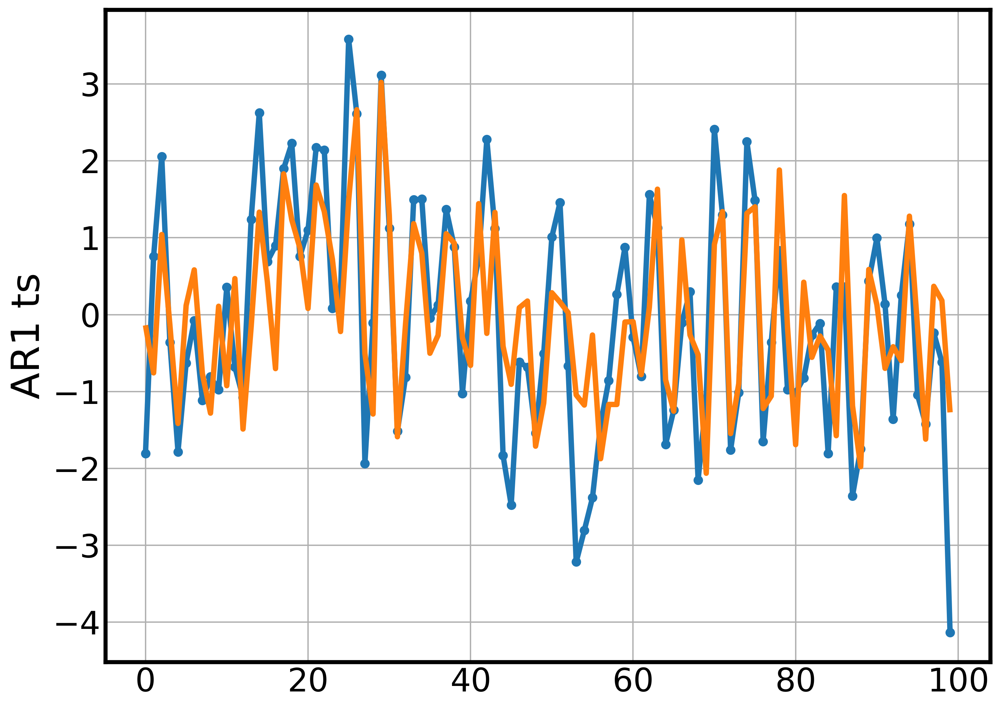

In [55]:
ax = ar3_ts.plot(legend=False,marker='o')
ax.plot(forecast)
ax.set_ylabel('AR1 ts');

Остатки выглядят как белый шум, что подтверждается, в первую очередь, АКФ и ЧАКФ

In [56]:
resid = ar3_ts - forecast

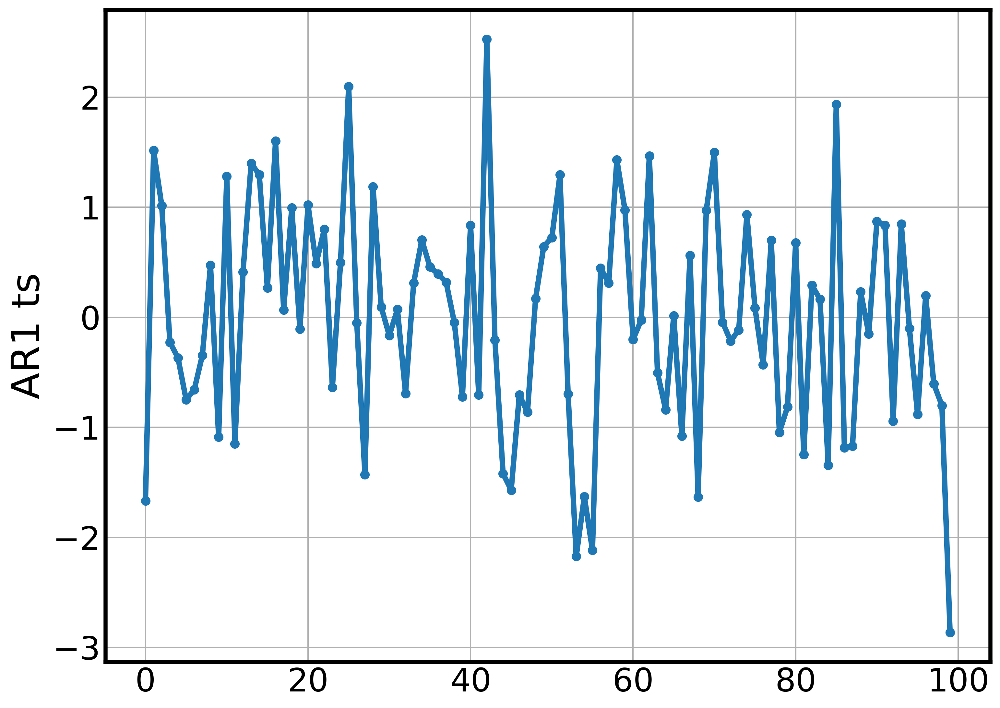

In [57]:
ax = resid.plot(legend=False,marker='o')
ax.set_ylabel('AR1 ts');

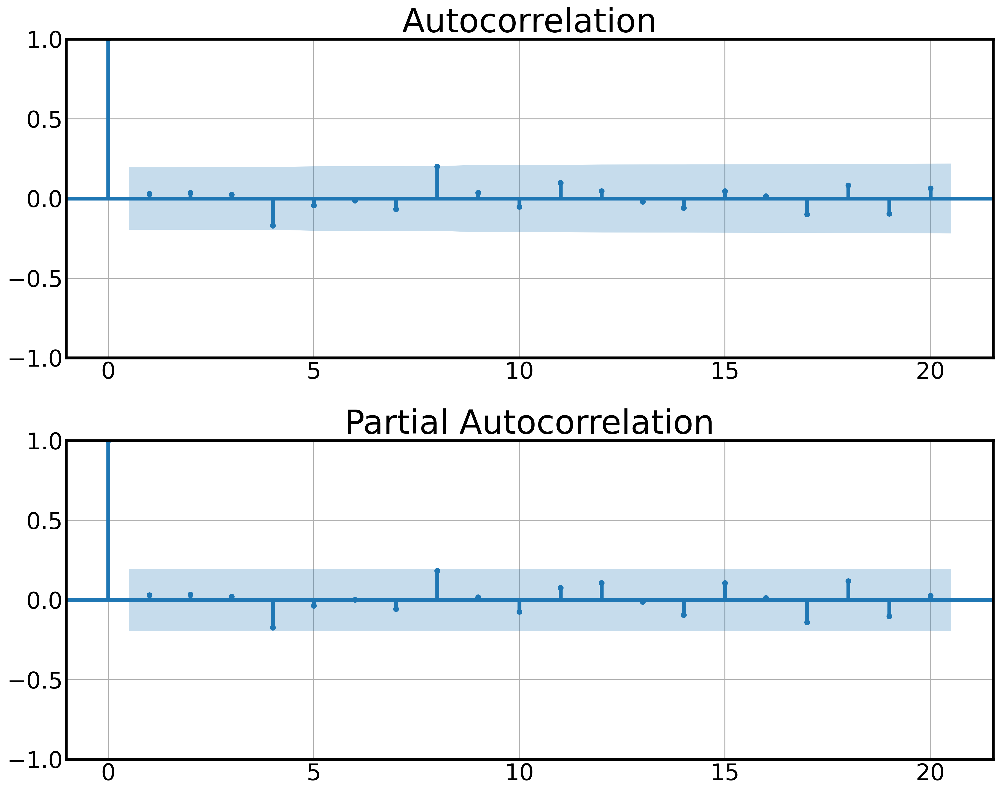

In [58]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(resid,ax=ax[0]);
tsaplots.plot_pacf(resid,ax=ax[1]);

Если обучим модель с большим колличеством параметров остатки также выглядят как белый шум

In [59]:
model = ARIMA(ar3_ts,order = (5,0,0))

model = model.fit(method = 'statespace')

forecast = model.predict(start=0,end=len(ar3_ts)-1)

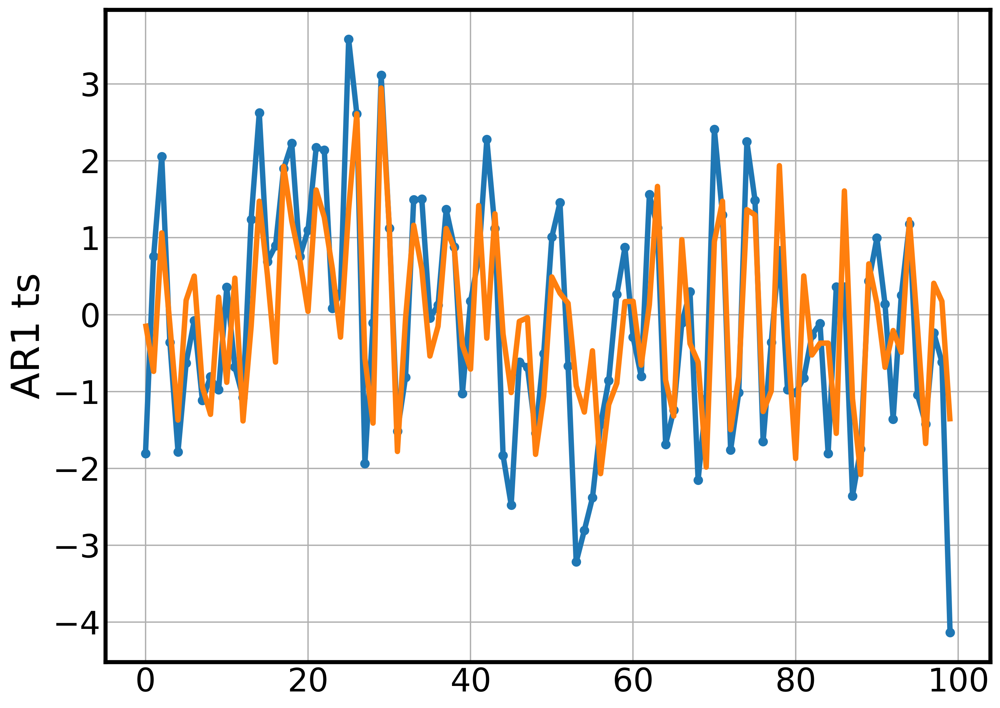

In [60]:
ax = ar3_ts.plot(legend=False,marker='o')
ax.plot(forecast)
ax.set_ylabel('AR1 ts');

In [61]:
resid = ar3_ts - forecast

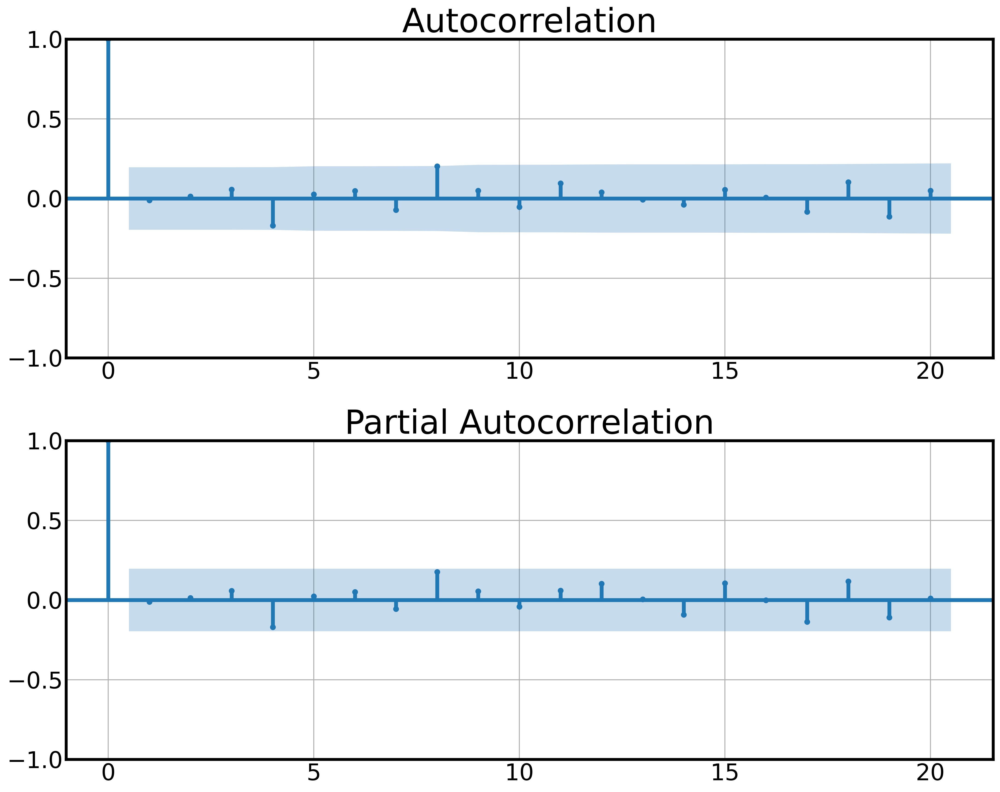

In [62]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(resid,ax=ax[0]);
tsaplots.plot_pacf(resid,ax=ax[1]);

не смотря на наличие 5 лагов, только первый три статзначимо отличны от нуля

In [63]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  100
Model:                 ARIMA(5, 0, 0)   Log Likelihood                -141.118
Date:                Mon, 22 Apr 2024   AIC                            296.236
Time:                        20:53:43   BIC                            314.472
Sample:                             0   HQIC                           303.617
                                - 100                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1162      0.268     -0.434      0.664      -0.641       0.408
ar.L1          0.8342      0.116      7.206      0.000       0.607       1.061
ar.L2         -0.7454      0.126     -5.895      0.000      -0.993      -0.498
ar.L3          0.6141      0.145      4.243      0.000       0.330       0.898
ar.L4          0.0169      0.147      0.115      0.908      -0.272       0.306
ar.L5         -0.0973      0.109     -0.894      0.371      -0.311       0.116
sigma2         0.9632      0.153      6.303      0.000       0.664       1.263
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 0.31
Prob(Q):                              0.97   Prob(JB):                         0.86
Heteroskedasticity (H):               1.22   Skew:                            -0.13
Prob(H) (two-sided):                  0.57   Kurtosis:                         2.91
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

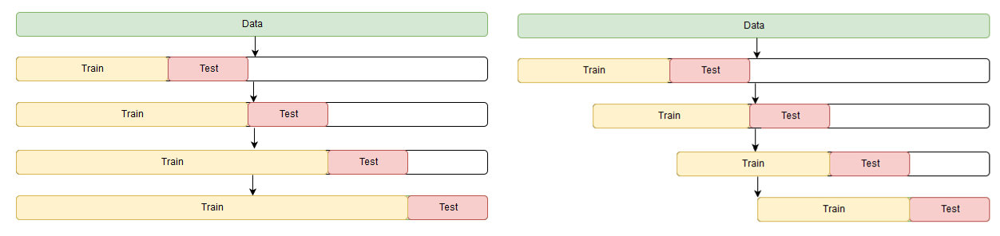

При прогнозирования с кросс-валидацией в моделях ARMA можно итерироваться как с переобучением модели на каждом шаге, так и без переобучения, просто с подстановкой новых значений вр

In [66]:
one_step_ahed_preds_ar3 = []
model = ARIMA(ar3_ts.iloc[:50],order = (3,0,0))
model.fit(method = 'statespace')
for i in range(50,100):
    model = ARIMA(ar3_ts.iloc[:i],order = (3,0,0))
    model = model.fit(method = 'statespace')
    one_step_ahed_preds_ar3.append(model.forecast(steps=1).values[0])

In [67]:
one_step_update_ahed_preds_ar3 = []
model = ARIMA(ar3_ts.iloc[:50],order = (3,0,0))
model = model.fit(method = 'statespace')
for i in range(49,100):
    model = model.append(ar3_ts[i:i+1].values, refit=False)
    one_step_update_ahed_preds_ar3.append(model.forecast(steps=1).values[0])

In [68]:
one_step_ahed_forecast_ar3 = pd.Series([0]*50+one_step_ahed_preds_ar3)
one_step_update_ahed_forecast_ar3 = pd.Series([0]*50+one_step_update_ahed_preds_ar3)

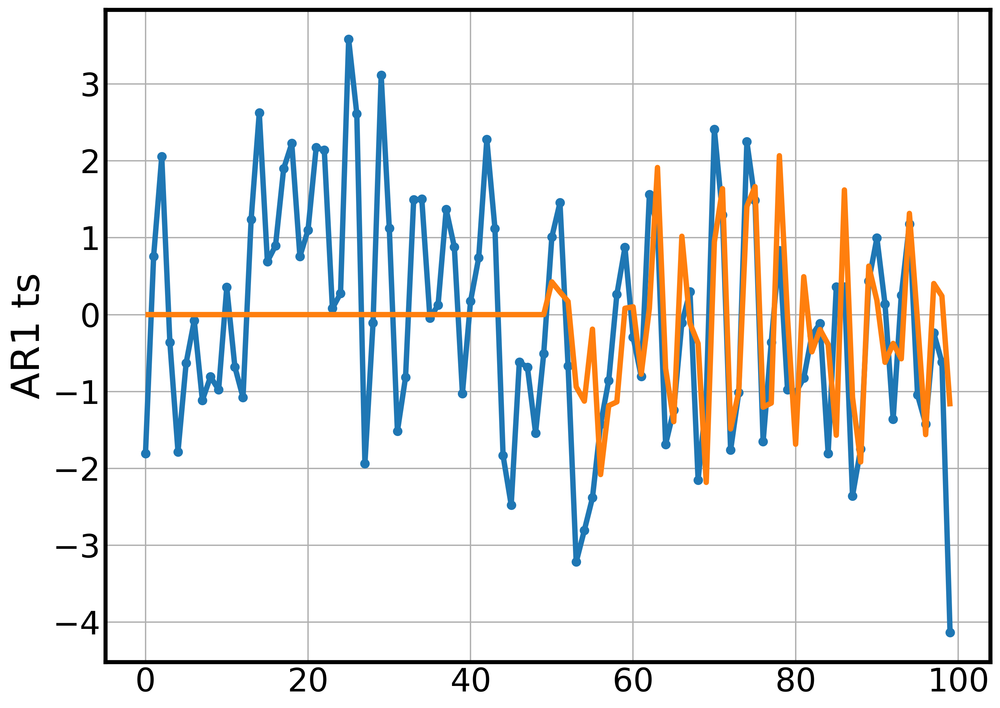

In [69]:
ax = ar3_ts.plot(legend=False,marker='o')
ax.plot(one_step_ahed_forecast_ar3)
ax.set_ylabel('AR1 ts');

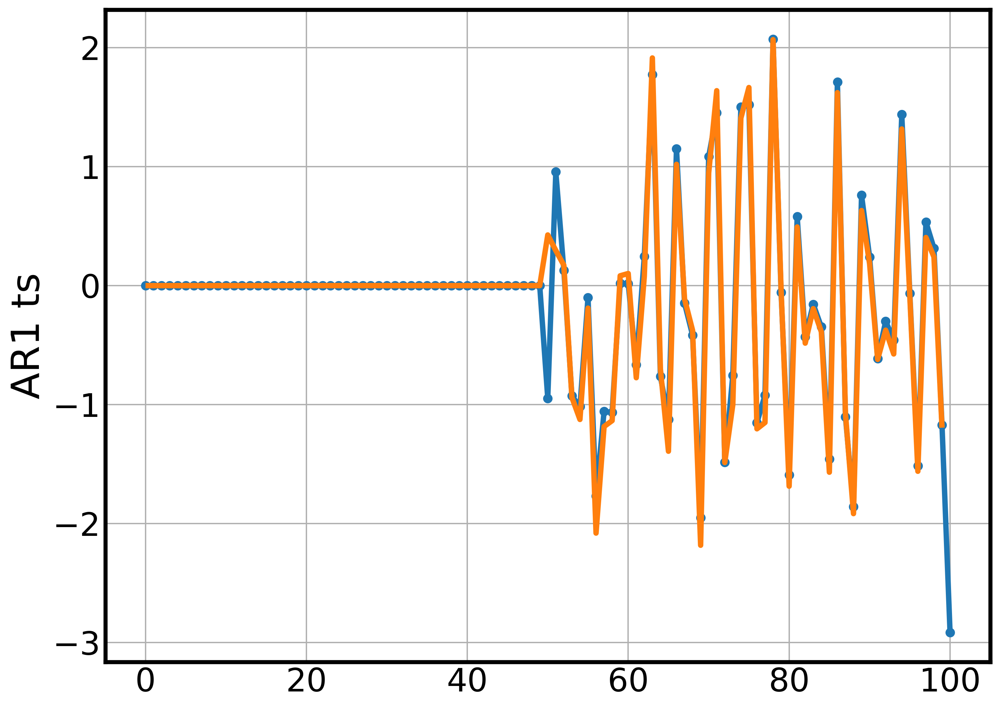

In [70]:
ax = one_step_update_ahed_forecast_ar3.plot(legend=False,marker='o')
ax.plot(one_step_ahed_forecast_ar3)
ax.set_ylabel('AR1 ts');

In [71]:
resid = ar3_ts.iloc[50:]-one_step_ahed_preds_ar3

<Axes: >

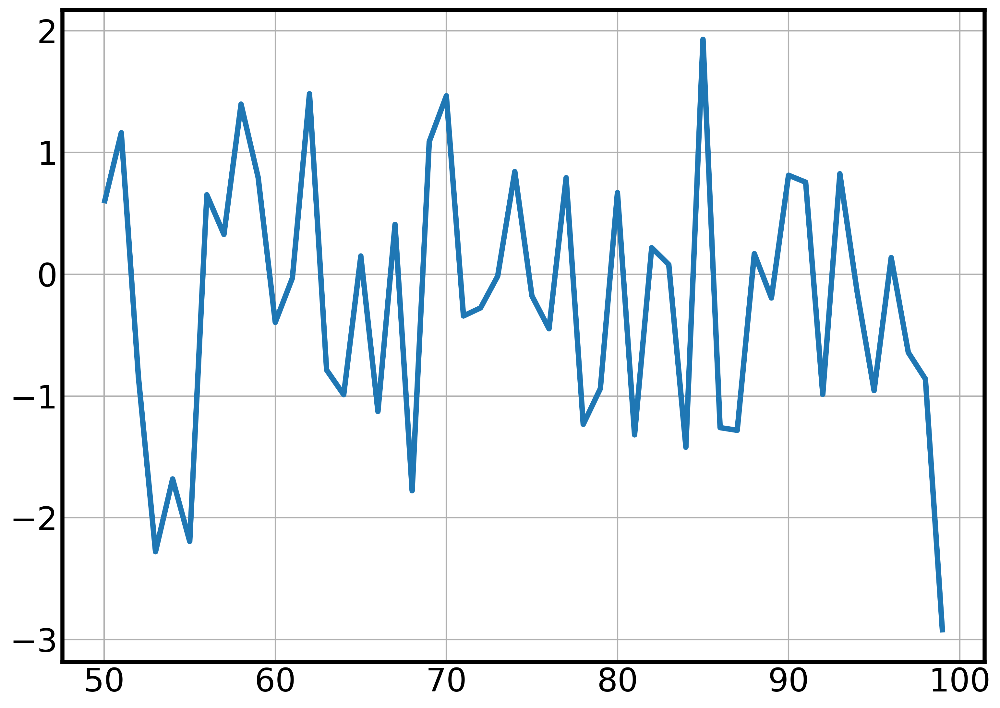

In [72]:
resid.plot()

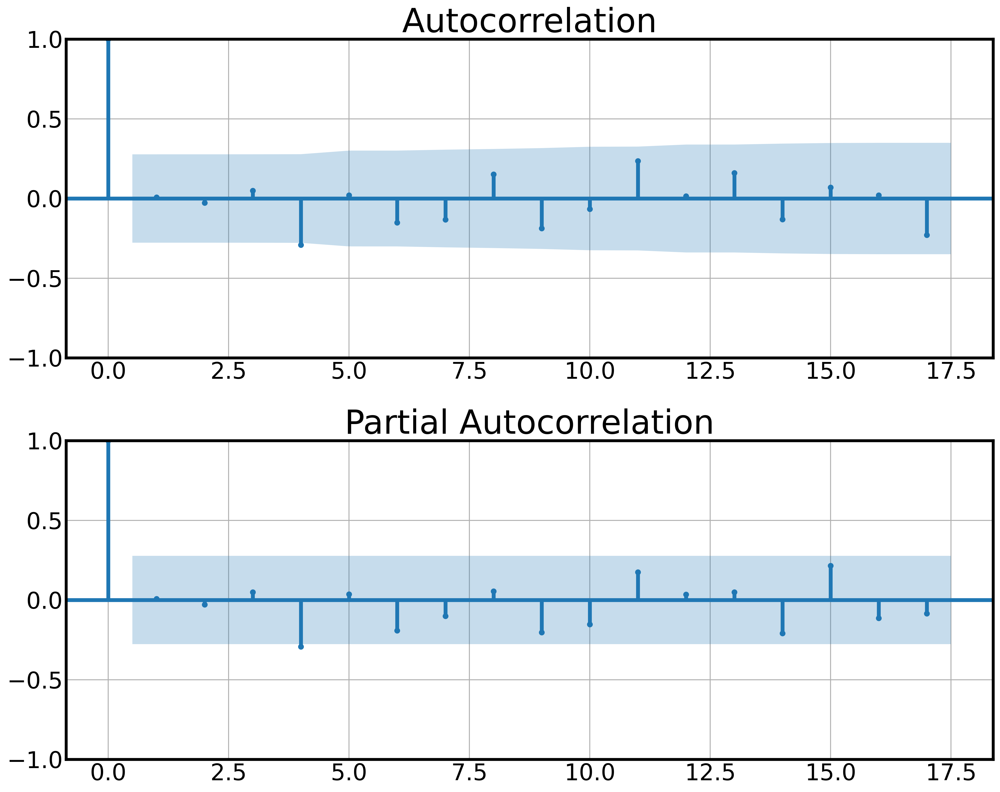

In [73]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(resid,ax=ax[0]);
tsaplots.plot_pacf(resid,ax=ax[1]);

При прогнозировании на большой горизонт предикты модели ARMA быстро выходят на среднее значение вр

In [74]:
model3 = ARIMA(ar3_ts,order = (3,0,0)).fit()

In [75]:
forecast_dyn3 = model3.predict(start=0,end=len(ar3_ts)-1, dynamic=50)

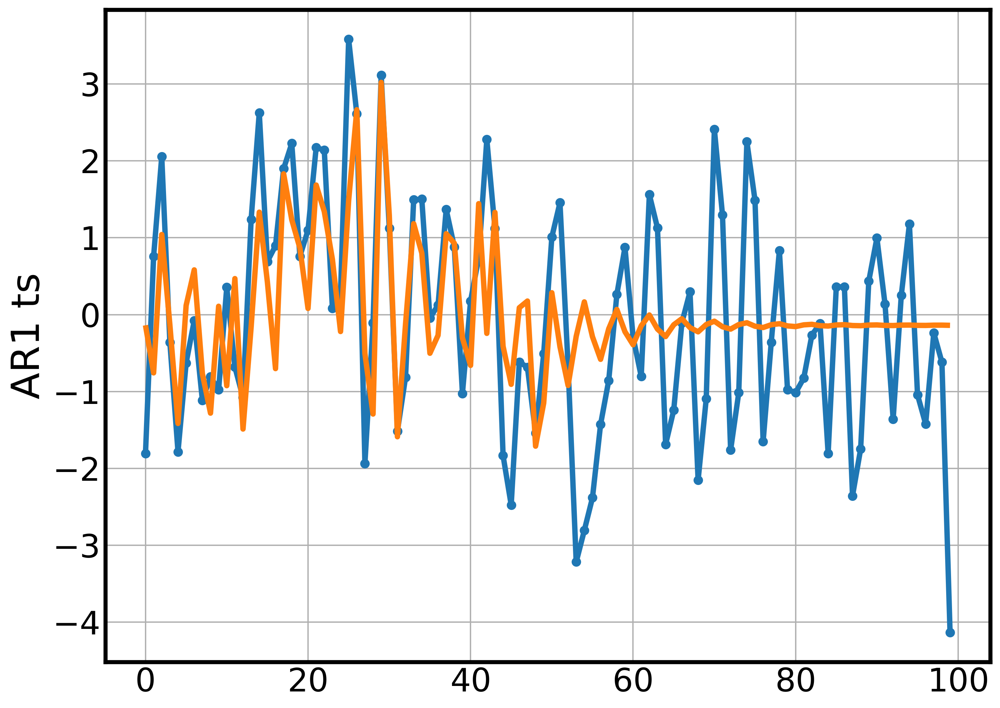

In [76]:
ax = ar3_ts.plot(legend=False,marker='o')
ax.plot(forecast_dyn3)
ax.set_ylabel('AR1 ts');

## ARMA (1,1)

In [77]:
arma11_model = sm.tsa.ArmaProcess(ar=[1,0.5],ma=[1, -0.4,],nobs=1000)
arma11_ts = pd.Series(arma11_model.generate_sample(burnin=10000))

In [78]:
arma11_model.isinvertible,arma11_model.isstationary

(True, True)

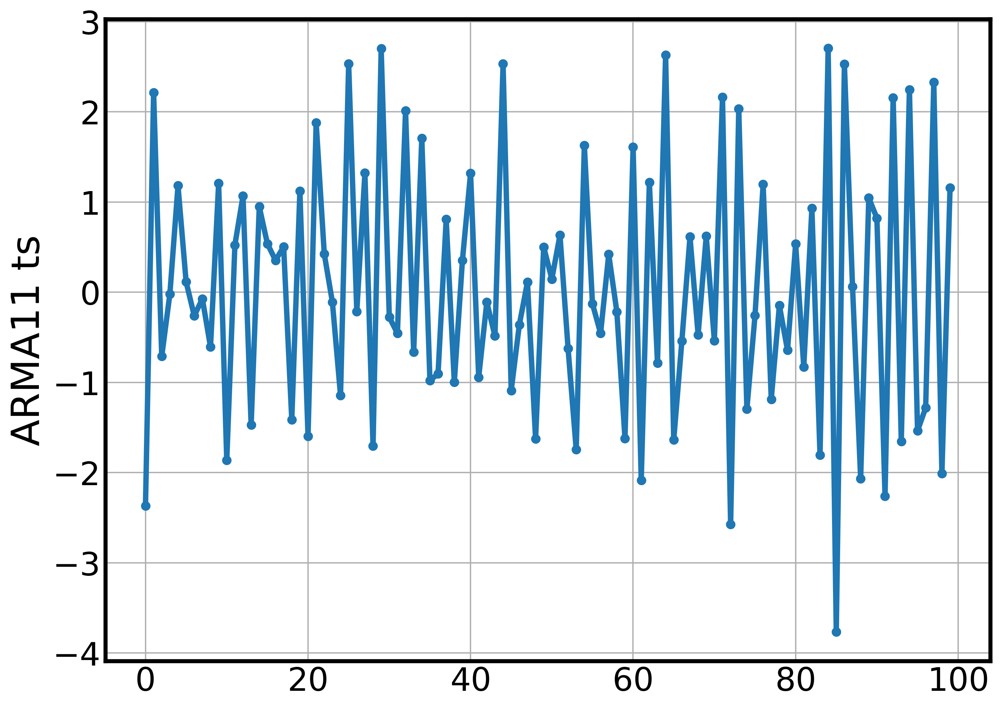

In [79]:
ax = arma11_ts.plot(legend=False,marker='o')
ax.set_ylabel('ARMA11 ts');

Строим графики автокорреляционной функции (ACF) и частичной автокорреляционной функции (PACF) и из этих графиков определяем примерные значения параметров p; q.


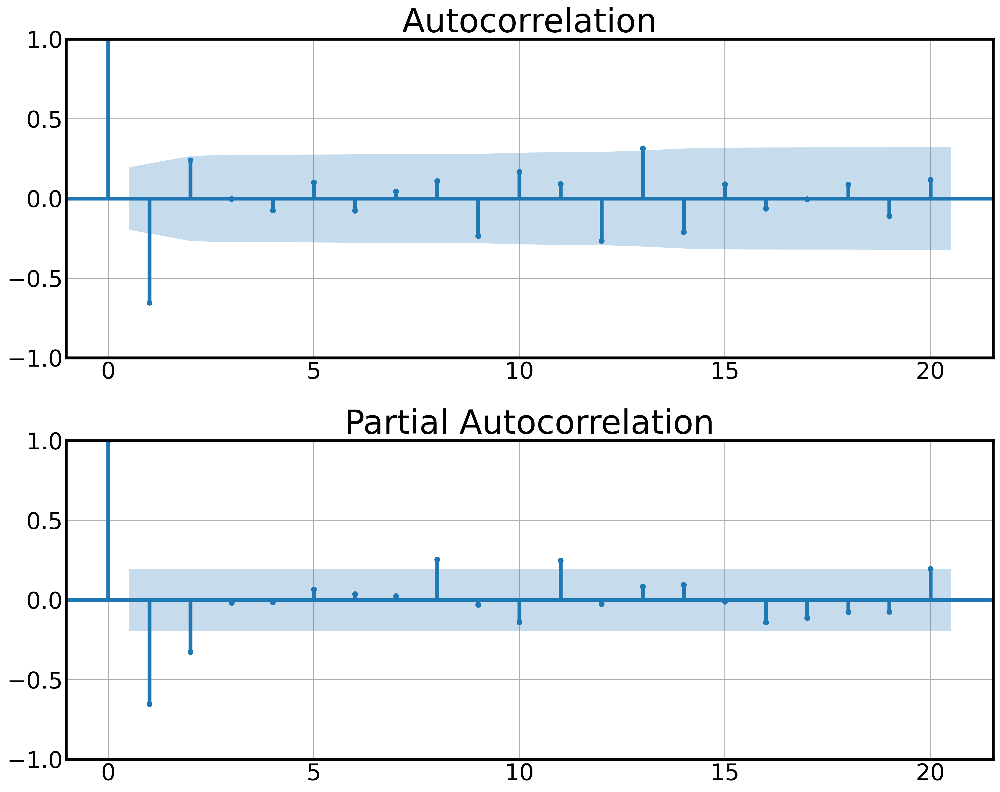

In [80]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(arma11_ts,ax=ax[0]);
tsaplots.plot_pacf(arma11_ts,ax=ax[1]);

In [81]:
model = ARIMA(arma11_ts,order = (1,0,1))

model = model.fit()

forecast = model.predict(start=0,end=len(arma11_ts)-1)

In [82]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  100
Model:                 ARIMA(1, 0, 1)   Log Likelihood                -142.760
Date:                Mon, 22 Apr 2024   AIC                            293.520
Time:                        21:04:02   BIC                            303.940
Sample:                             0   HQIC                           297.737
                                - 100                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0347      0.044      0.790      0.430      -0.051       0.121
ar.L1         -0.4878      0.118     -4.136      0.000      -0.719      -0.257
ma.L1         -0.3722      0.130     -2.869      0.004      -0.626      -0.118
sigma2         1.0098      0.175      5.777      0.000       0.667       1.352
===================================================================================
Ljung-Box (L1) (Q):                   0.04   Jarque-Bera (JB):                 1.77
Prob(Q):                              0.83   Prob(JB):                         0.41
Heteroskedasticity (H):               0.90   Skew:                             0.04
Prob(H) (two-sided):                  0.77   Kurtosis:                         2.35
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

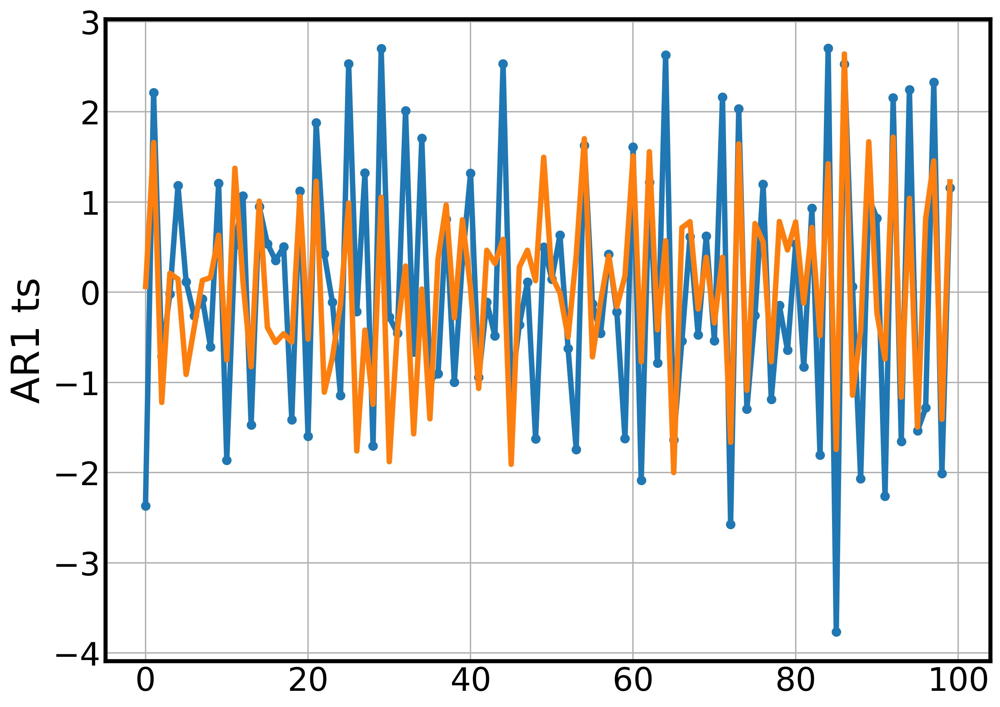

In [83]:
ax = arma11_ts.plot(legend=False,marker='o')
ax.plot(model.fittedvalues)
ax.set_ylabel('AR1 ts');

In [ ]:
1 - model.resid.std()/arma11_ts.std()

## ARMA(2,2)

In [84]:
arma22_model = sm.tsa.ArmaProcess(ar=[1,0.5,0.55],ma=[1, -0.4, 0.3],nobs=1000)
arma22_ts = pd.Series(arma22_model.generate_sample(burnin=10000))

In [85]:
arma22_model.isinvertible,arma22_model.isstationary

(True, True)

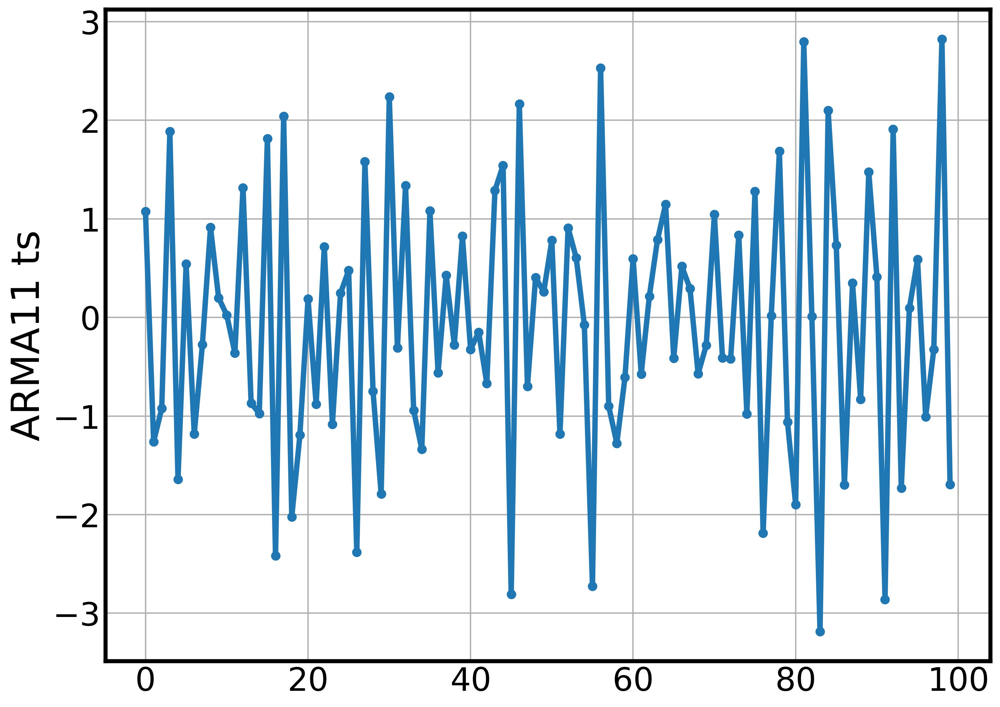

In [86]:
ax = arma22_ts.plot(legend=False,marker='o')
ax.set_ylabel('ARMA11 ts');

Строим графики автокорреляционной функции (ACF) и частичной автокорреляционной функции (PACF) и из этих графиков определяем примерные значения параметров p; q.


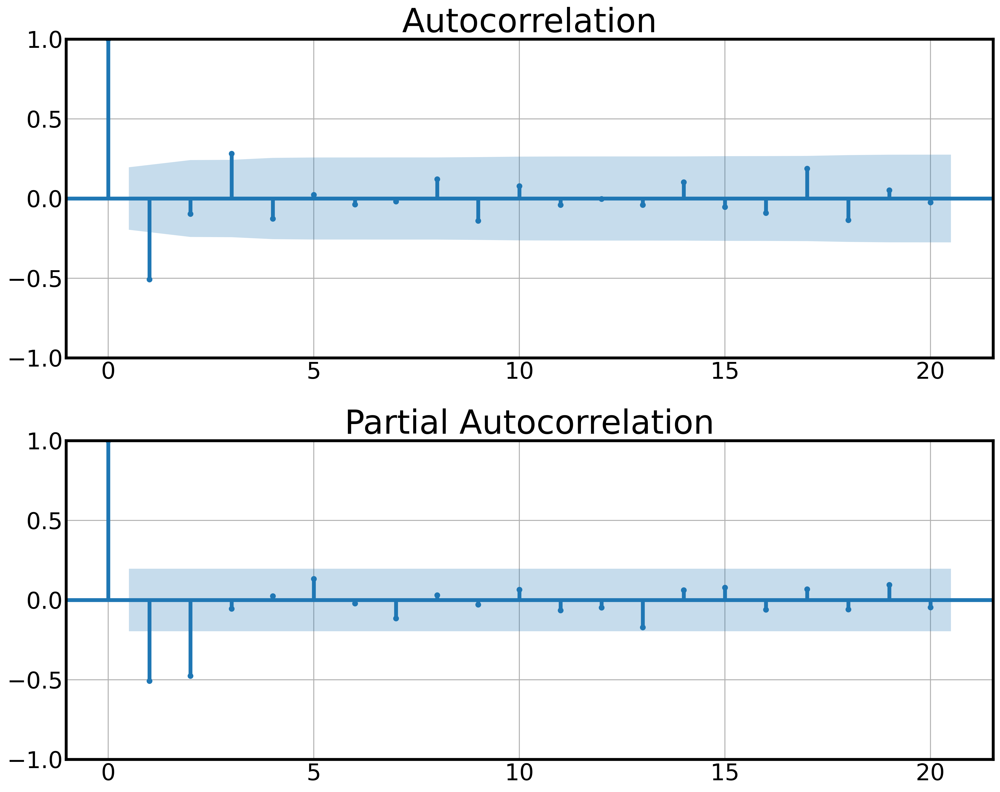

In [87]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(arma22_ts,ax=ax[0]);
tsaplots.plot_pacf(arma22_ts,ax=ax[1]);

In [88]:
ps = range(0, 3)
qs = range(0, 4)

In [89]:
parameters = product(ps, qs)
parameters_list = list(parameters)
len(parameters_list)

12

In [90]:
%%time
results = []
best_aic = float("inf")
warnings.filterwarnings('ignore')

for param in parameters_list:
    #try except нужен, потому что на некоторых наборах параметров модель не обучается
    try:
        model=ARIMA(arma22_ts, order=(param[0], 0, param[1])).fit()
    #выводим параметры, на которых модель не обучается и переходим к следующему набору
    except ValueError:
        print('wrong parameters:', param)
        continue
    aic = model.aic
    bic = model.bic
    #сохраняем лучшую модель, aic, параметры
    if aic < best_aic:
        best_model = model
        best_aic = aic
        best_param = param
    results.append([param, model.aic, model.bic])
    
warnings.filterwarnings('default')

CPU times: user 1.17 s, sys: 1.76 s, total: 2.93 s
Wall time: 887 ms


In [91]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'aic', 'bic']
print(result_table.sort_values(by = 'aic', ascending=True).head())
print(result_table.sort_values(by = 'bic', ascending=True).head())

   parameters         aic         bic
8      (2, 0)  292.659403  303.080084
9      (2, 1)  294.529316  307.555167
10     (2, 2)  294.854415  310.485436
11     (2, 3)  296.872477  315.108668
7      (1, 3)  297.037231  312.668253
   parameters         aic         bic
8      (2, 0)  292.659403  303.080084
9      (2, 1)  294.529316  307.555167
2      (0, 2)  297.711825  308.132506
1      (0, 1)  302.224402  310.039913
10     (2, 2)  294.854415  310.485436


In [92]:
model_aic = ARIMA(arma22_ts,order=(2,0,0)).fit()
model_bic = ARIMA(arma22_ts,order=(2,0,1)).fit()

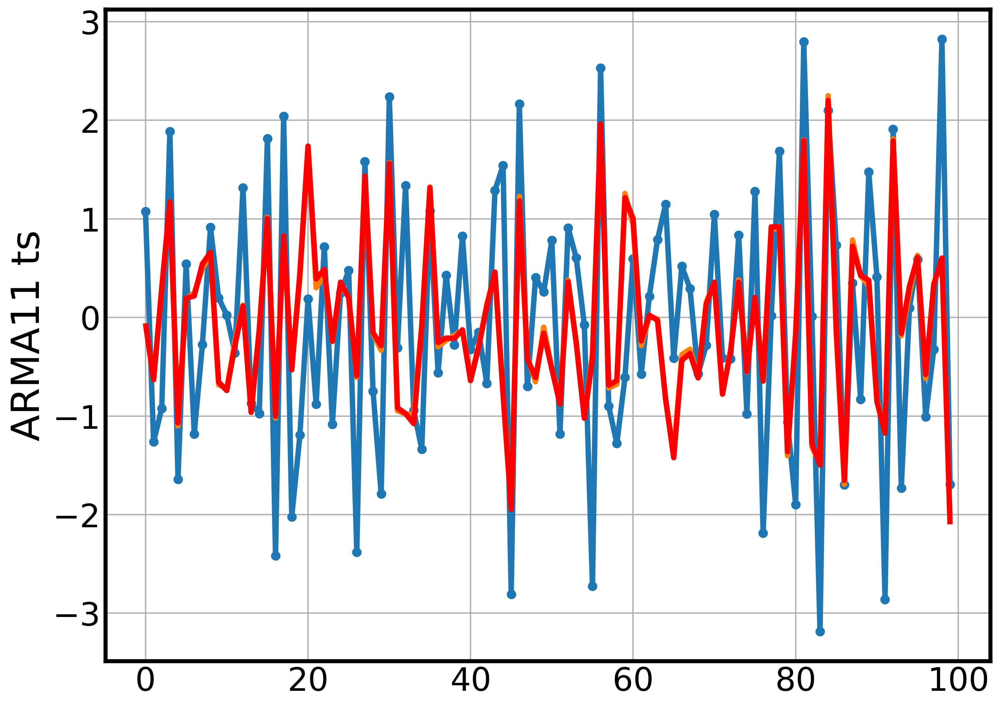

In [93]:
ax = arma22_ts.plot(legend=False,marker='o')
ax.plot(model_aic.fittedvalues)
ax.plot(model_bic.fittedvalues,c='red')
ax.set_ylabel('ARMA11 ts');

In [94]:
model_aic.resid.std(),model_bic.resid.std()

(1.0084832528743137, 1.0078303921299523)

In [95]:
arma22_ts.std()

1.3326687459832995

Сравним нашу модель с автоаримой

In [97]:
from sktime.forecasting.arima import AutoARIMA

In [98]:
forecaster = AutoARIMA(seasonal=False,
                       d=0, 
                       max_p=5, 
                       max_q=5,
                       information_criterion = 'aicc',
                       suppress_warnings=True)   

In [99]:
forecaster.fit(arma22_ts)

AutoARIMA(d=0, information_criterion='aicc', seasonal=False,
          suppress_warnings=True)

In [100]:
forecaster.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  100
Model:               SARIMAX(2, 0, 0)   Log Likelihood                -143.180
Date:                Mon, 22 Apr 2024   AIC                            292.360
Time:                        21:12:59   BIC                            300.176
Sample:                             0   HQIC                           295.523
                                - 100                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7403      0.100     -7.377      0.000      -0.937      -0.544
ar.L2         -0.4718      0.079     -5.945      0.000      -0.627      -0.316
sigma2         1.0179      0.159      6.402      0.000       0.706       1.330
===================================================================================
Ljung-Box (L1) (Q):                   0.11   Jarque-Bera (JB):                 0.95
Prob(Q):                              0.74   Prob(JB):                         0.62
Heteroskedasticity (H):               0.88   Skew:                            -0.12
Prob(H) (two-sided):                  0.72   Kurtosis:                         2.59
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [101]:
forecaster.is_fitted

True

In [102]:
forecaster.get_fitted_params()

{'ar.L1': -0.7402905021921908,
 'ar.L2': -0.47181681301516276,
 'sigma2': 1.0179257601445904,
 'order': (2, 0, 0),
 'seasonal_order': (0, 0, 0, 0),
 'aic': 292.36019538952183,
 'aicc': 292.61019538952183,
 'bic': 300.1757059474861,
 'hqic': 295.5232731443692}

In [ ]:
forecaster._forecaster.model_.resid().std()

Сравним ошибки моделей

In [103]:
from sklearn.metrics import mean_absolute_error, r2_score,mean_squared_error, mean_squared_log_error

In [104]:
metrics = [mean_absolute_error, r2_score,mean_squared_error]

In [105]:
trends_list=[pd.Series([arma22_ts.mean() for x in range(len(arma22_ts))]),
             model_aic.fittedvalues,
             model_bic.fittedvalues,
             forecaster._forecaster.model_.fittedvalues()]

In [106]:
cm = sns.light_palette("green", as_cmap=True,reverse=True,)
error_df = pd.DataFrame([[metr(arma22_ts,
       tren[tren.notna()]) for metr in metrics] for tren in trends_list],
            index=['mean','aic','bic','auto'],
            columns=[metr.__name__ for metr in metrics])

error_df.style.background_gradient(cmap=cm)

,mean_absolute_error,r2_score,mean_squared_error
mean,1.081152,0.000000,1.758246
aic,0.816755,0.427328,1.006897
bic,0.818999,0.428072,1.005590
auto,0.817775,0.417648,1.023918


# Проверка остатков

Остатки — разность между фактом и прогнозом:
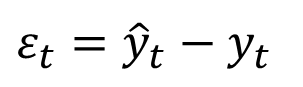

Желательные свойства остатков:
1. Несмещённость — равенство среднего значения нулю
2. Стационарность — отсутствие зависимости от времени
3. Неавтокоррелированность — отсутствие неучтённой зависимости от предыдущих наблюдений
4. «Нормальность» - имеют нормальное распределение
5. Гомоскедастичность — однородность дисперсии


Если остатки модели нормальны и гомоскедастичны, предсказательные интервалы определяются теоретически. Например, для прогноза на следующую точку предсказательный интервал — $\hat{y}_{t+1}\pm1.96\sigma^2$

Если нормальность или гомоскедастичность не выполняется, предсказательные интервалы можно оценить с помощью симуляции. 

Для каждого свойства мы будем проверять соответствующие гипотезы. Давайте вспомним примерный алгоритм проверки гипотез:

1. У нас имеется выборка $Y_t = (y_1,y_2,...,y_t)$,  которая имеет неизвестное распределение $y_t \sim P$
2. Мы делаем предположение об этом распределении (нулевая гипотеза) $H_0: P \in \omega$ и формируем альтернативную гипотезу $H_0: P \notin \omega$
3. Далее мы собираем статистику $T(y_t)$, которая имеет известное распределение $T(y_t) \sim F(Y_t)$ при справедливости нулевой гипотезы, а если справедлива альтернатива, то распределение статистики — какое-то другое $T(y_t) \sim F'(Y_t)$.
4. Подсчитываем значение статистики для нашей выборки: $T(y_t) = t$
5. Подсчитываем достигаемый уровень значимости $p(y_t)$ - вероятность при $H_0$ получить $T(y_t) = t$ или более экстремальное значение статистики $p(y_t) = P(T \ge t| H_0)$
6.Гипотеза отвергается при $p(y_t) \le \alpha$, где $\alpha$ - уровень значимости

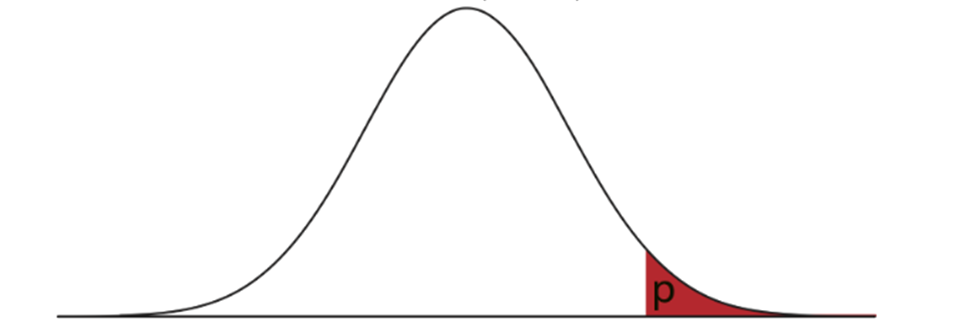

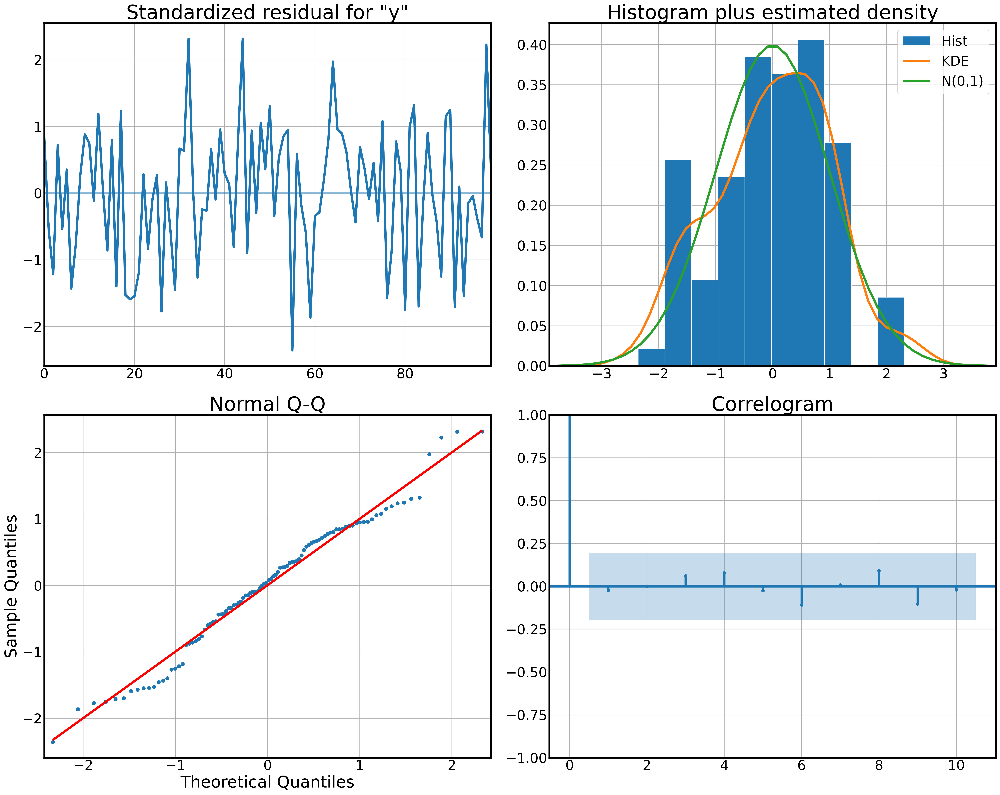

In [107]:
model_aic.plot_diagnostics(figsize=(25,20));

## Проверка на несмещенность

### Если остатки распределены "около"-нормально

В этом случае используется Т-тест Стьюдента. Он проверяет нулевую гипотезу о равенстве среднего значения $\overline{e_{t}}$ выборки $e_{t} = (e_1,..e_t)$ определенному значению

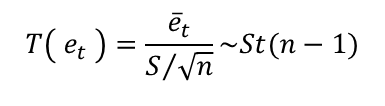

где $S$ - выборочное стандартное отклонение.

In [108]:
from scipy.stats import ttest_1samp

In [109]:
model_aic.resid.mean()

0.005411613518140681

In [110]:
ttest_1samp(model_aic.resid,0)

TtestResult(statistic=0.05366091606099408, pvalue=0.9573134582467865, df=99)

In [111]:
ttest_1samp(model_aic.resid,0.5)

TtestResult(statistic=-4.904279620630442, pvalue=3.6799982906394907e-06, df=99)

### Если остатки распределены совсем "ненормально"

Если центральная предельная теорема не всегда применима: иногда
распределения бывают слишком скошенные, иногда выборка недостаточно большая, чтобы распределение ее
выборочного среднего можно было считать нормальным, рекомендуется применять критерий Уилкоксона, если распределение симметрично относительно медианы, в противном случае - критерий Знаков

Критерий Уилкоксона

Критерий Уилкоксона проверяет нулевую гипотезу о равенстве медианы $ med(e_{t}) = m_0$ выборки $e_{t} = (e_1,..e_t)$ определенному значению 
Исходный ВР упорядочивают по возврастанию и проверяют следующую статистику о рангах

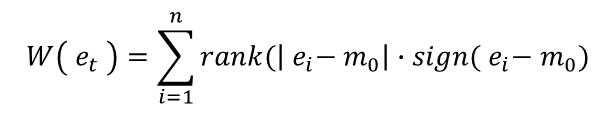

При справедливости нулевой гипотезы каждый из рангов в выборке мог с одинаковой вероятностью реализоваться с любым знаком $(sign(e_i − m_0))$: и с «+», и с «−». Таким образом, получается 2n вариантов
распределения знаков по рангам. Перебирая все эти варианты, для каждого из них можно вычислить значение статистики. При $n>20$ имеют нормальную аппроксимацию

In [112]:
from scipy.stats import wilcoxon

In [113]:
wilcoxon(model_aic.resid)

WilcoxonResult(statistic=2459.0, pvalue=0.8204786096104631)

In [114]:
wilcoxon(model_aic.resid-0.5)

WilcoxonResult(statistic=1269.0, pvalue=1.5706760228924285e-05)

Критерии знаков

Проверяет проверяет нулевую гипотезу о равенстве медианы $ med(e_{t}) = m_0$ выборки $e_{t} = (e_1,..e_t)$ определенному значению. Обладают невысокой мощностью, но они крайне универсальны и практически ничего не требуют от данных, поэтому они очень полезны на практике. Собирает статиститику $T(e_t) = \sum^{n}_{i = 1}[e_i>m_0]$, которая при справедливости нулевой гипотезы имеет биномиальное распределение

In [115]:
from statsmodels.stats.descriptivestats import sign_test

In [116]:
sign_test(model_aic.resid)

(2.0, 0.7643534344026673)

In [117]:
sign_test(model_aic.resid,0.5)

(-15.0, 0.0035176417229701587)

## Критерии проверки на стационарность временного ряда

Критерии проверки на стационарность также называются критериями проверки на единичный корень, т.к.

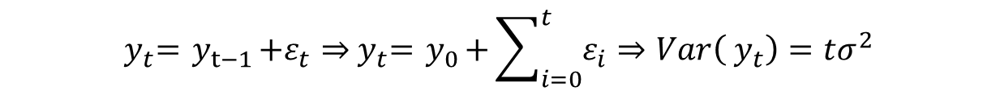

### Критерий Дики-Фуллера

Проверяет следующую модель авторегрессии

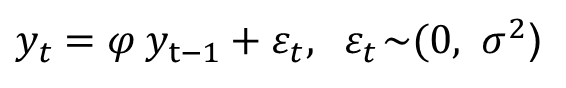

Нулевая гипотеза $H_0: \phi=1$ - ряд нестационарен против альтернативы $H_0: \phi<1$ . Статистика $T(y_t) = \frac{\hat{\phi}-\phi}{s_{\hat{\phi}}}$ имеет табличное распределение

Почти всегда на практике применяется Расширенный тест Дики — Фуллера (Augmented DF) – в регрессии используется не один лаг авторегрессии, а несколько


In [118]:
from statsmodels. tsa.stattools import adfuller

In [119]:
adfuller(model_aic.resid)[1]

7.860496823016805e-18

### Критерий КПСС

Критерий КПСС проверяет гипотезу о стационарности временного ряда вокруг детерминированного тренда:

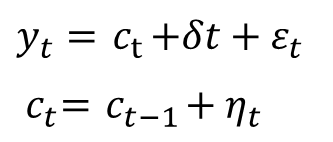

Рассматривается нулевая гипотеза, что ряд стационарен $H_0: \sigma_{\eta_t} = 0$ против альтернативы, что ряд нестационарен $\sigma_{\eta_t} \ne 0$. Статистика критерия

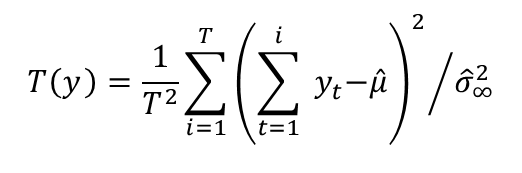

имеет специальное табличное распределение, а $\sigma_{\infty} = 0$ - Стандартная ошибка в форме Ньюи-Веста

In [120]:
from statsmodels. tsa.stattools import kpss

In [121]:
kpss(model_aic.resid)

/tmp/ipykernel_362540/418886455.py:1: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss(model_aic.resid)


(0.13713084818323418,
 0.1,
 0,
 {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739})

При одновременном применении критериев KPSS и ADF могут получиться следующие результаты: 
    
* Вариант 1: Оба теста говорят, что ряд нестационарный – значит, ряд действительно нестационарный

* Вариант 2: Оба теста говорят, что ряд стационарный – ряд стационарный

* Вариант 3: KPSS говорит, что ряд стационарный, а ADF говорит, что ряд нестационарный – значит, у вр существует детерминированный тренд, который необходимо убрать, чтобы получить стационарный вр

* Вариант 4: KPSS говорит, что ряд нестационарный, а ADF - что ряд стационарный – значит, у вр существует стохастический тренд, который необходимо убрать, чтобы получить стационарный вр


## Проверка на нормальность

### Q-Q график

In [122]:
x0 = np.random.normal(size = 10000)

In [123]:
from statsmodels.graphics.gofplots import qqplot

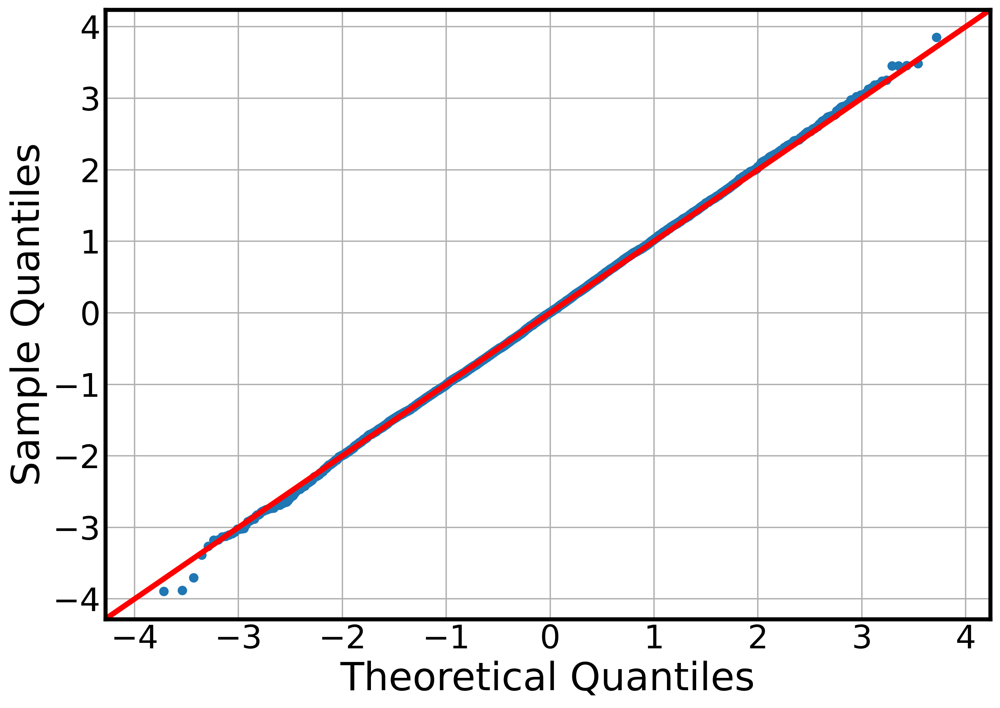

In [124]:
qqplot(x0,line='45');

In [127]:
x1 = np.random.normal(scale=0.2,size = 10000)

<Axes: ylabel='Count'>

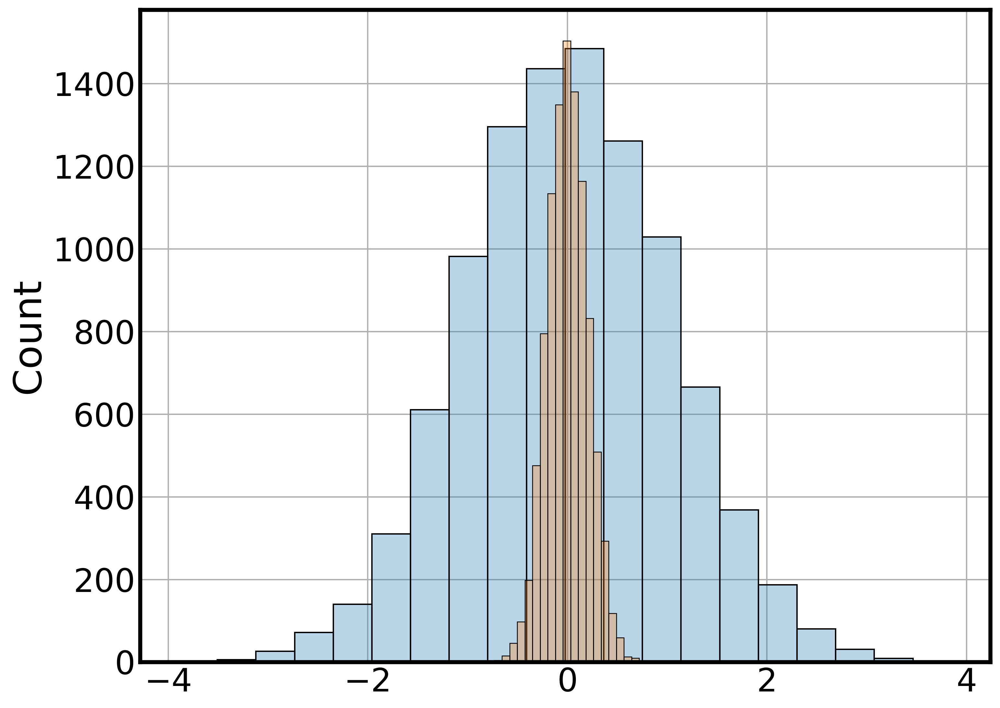

In [128]:
sns.histplot(x0,bins=20,alpha=0.3)
sns.histplot(x1,bins=20,alpha=0.3)

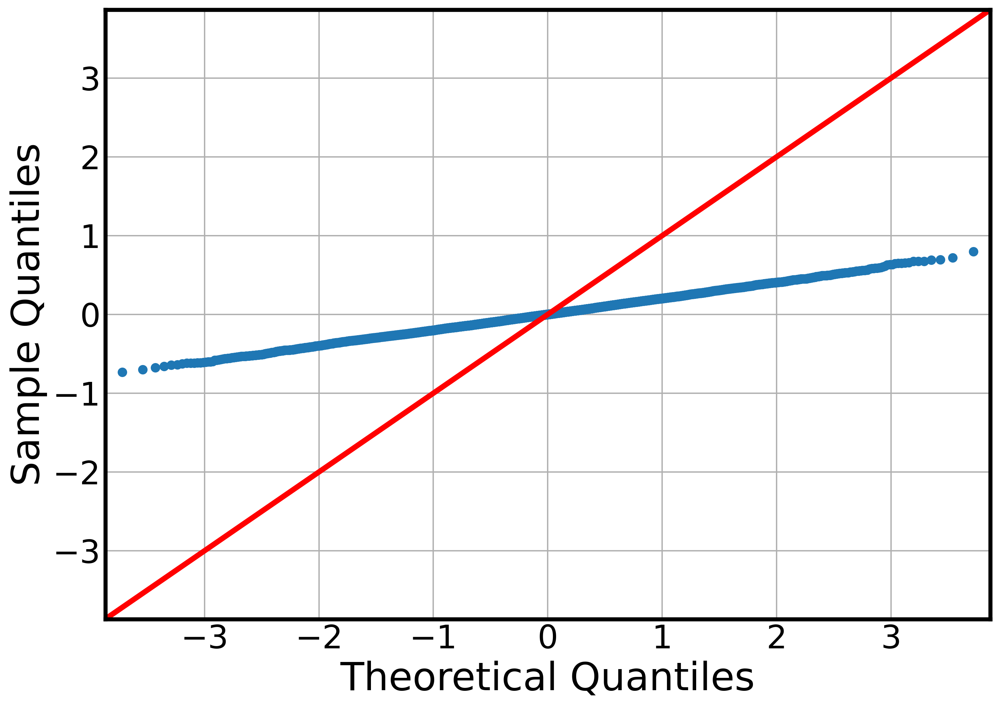

In [129]:
qqplot(x1,line='45',scale=1);

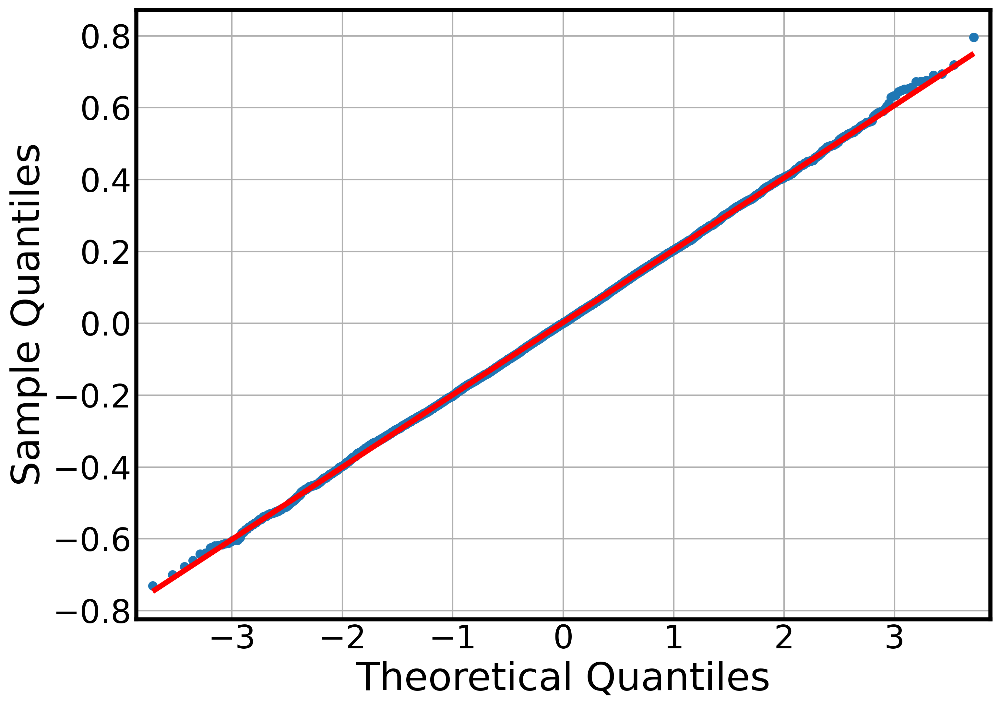

In [130]:
qqplot(x1,line='s',scale=1);

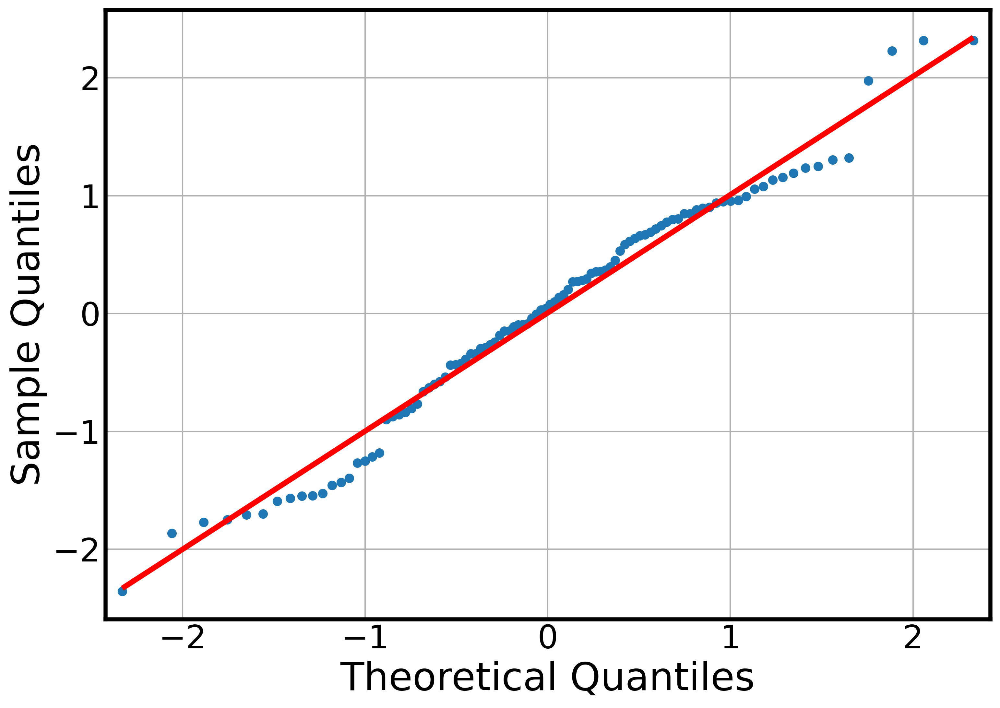

In [131]:
qqplot(model_aic.resid,line='s');

### Критерий Шапиро-Уилка

Критерий Шапиро-Уилка используется для проверки гипотезы $H_0$: «случайная величина X распределена нормально» и является одним наиболее эффективных критериев проверки нормальности.  Критерий Шапиро-Уилка основан на оптимальной линейной несмещённой оценке дисперсии к её обычной оценке методом максимального правдоподобия. Статистика критерия имеет вид:

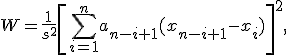

где $s$ - средневыборочное отклонение, $a_{n-i+1}$ - специальные табличные коэффициенты.

In [132]:
from scipy.stats import shapiro

In [133]:
shapiro(model_aic.resid)

ShapiroResult(statistic=0.9792371392250061, pvalue=0.11591298133134842)

<Axes: >

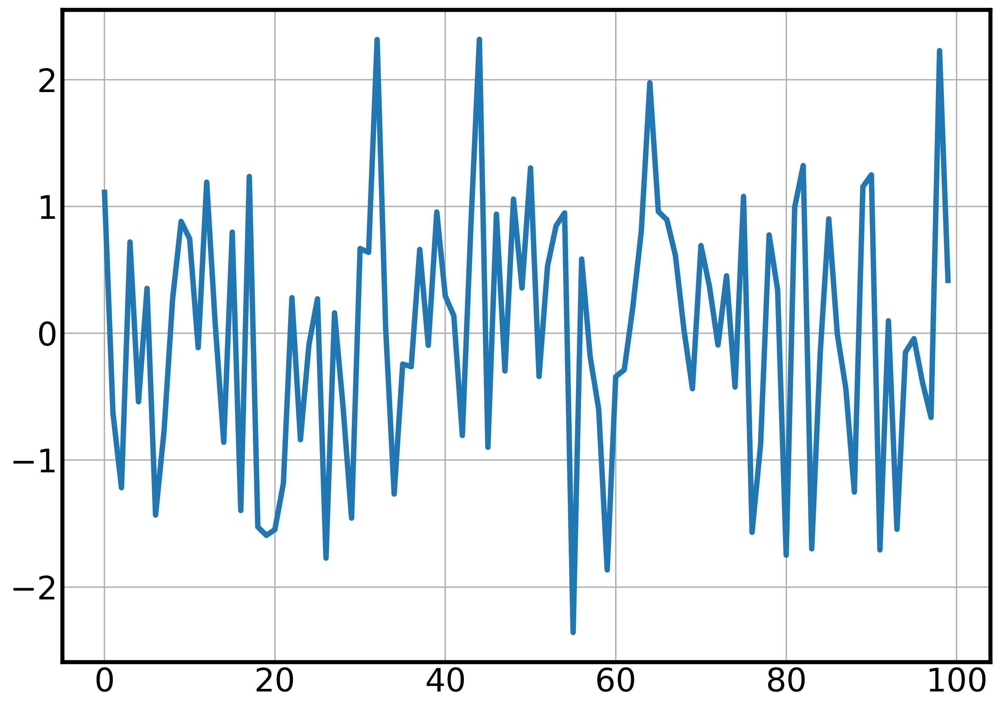

In [135]:
model_aic.resid.plot()

In [134]:
shapiro(x1)

/home/dssaburi/myenv/py38_nbt_env/lib/python3.8/site-packages/scipy/stats/_morestats.py:1816: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ShapiroResult(statistic=0.999794602394104, pvalue=0.4761442244052887)

## Дополнительные критерии проверки остатков

### Проверка на неавтокоррелированность (Q-критерий Льюнга-Бокса)

Критерий Льюнга-Бокса проверяет остатки на отсутствие автокореляций (формализует графическую проверку королеллограммы). Нулевая гипотеза $H_0 = r_1 = r_2 = ... = r_p = 0$ против альтернативы $H_1$ - $H_0$ неверна. Статистика критерия - 

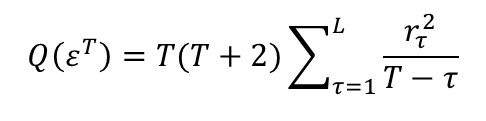

имеет распределение $\chi^2_{L-K}$, где 𝐾 — число настраиваемых параметров модели ряда, 𝐿 – число лагов для проверки. Разработан специально для проверки остатков модели

In [136]:
from statsmodels.stats.diagnostic import acorr_ljungbox

In [137]:
acorr_ljungbox(model_aic.resid,model_df=0,lags=5)

,lb_stat,lb_pvalue
1,0.062714,0.802257
2,0.065853,0.967610
3,0.486523,0.921842
4,1.104795,0.893511
5,1.162431,0.948430


### Проверка на гомоскедастичность (критерий Бройша-Пагана) 

Критерий проверяет остатки модели на гомоскедастичность (отсутствие зависимости от х), строя линейную модель на квадрат остатков. Нулевая гипотеза -  $\sigma_1=\sigma_2=...=\sigma_p = const$, против альтернативы, что $H_0$ неверна. Статистика критерия - $T(e_t) = nR^2$ имеет распределение $\chi^2$, где $R^2$, - коэффициент детерминации при регрессии квадратов остатков $e_t$ исходной модели  на время. 

In [138]:
from statsmodels.stats.diagnostic import het_breuschpagan

In [139]:
het_breuschpagan(model_aic.resid.values,
                 sm.add_constant(np.array(list(range(len(model_aic.resid.dropna()))))))

(0.15221519057179167,
 0.6964273678082877,
 0.14939829365776197,
 0.6999489957487262)

<Axes: >

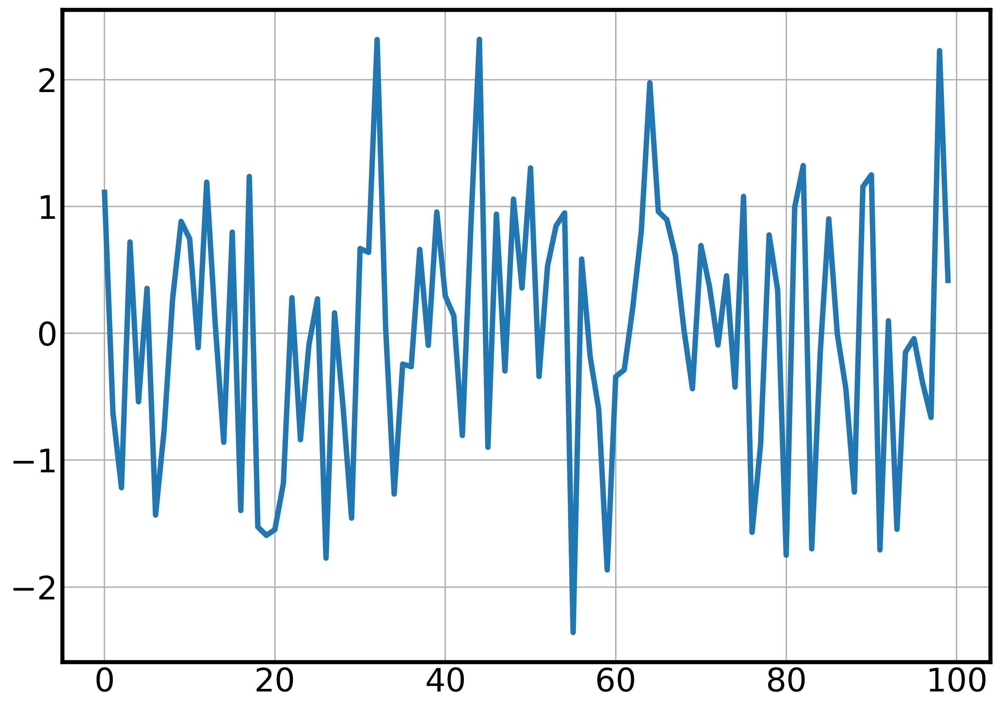

In [140]:
best_model.resid.plot()

In [141]:
het_breuschpagan(x0,
                 sm.add_constant(np.array(list(range(len(x0))))))

(0.021189022042511496,
 0.8842651986968935,
 0.021184829126658235,
 0.884279503628901)

# Преобразование Бокса-Кокса

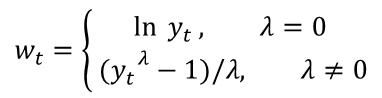

In [142]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)

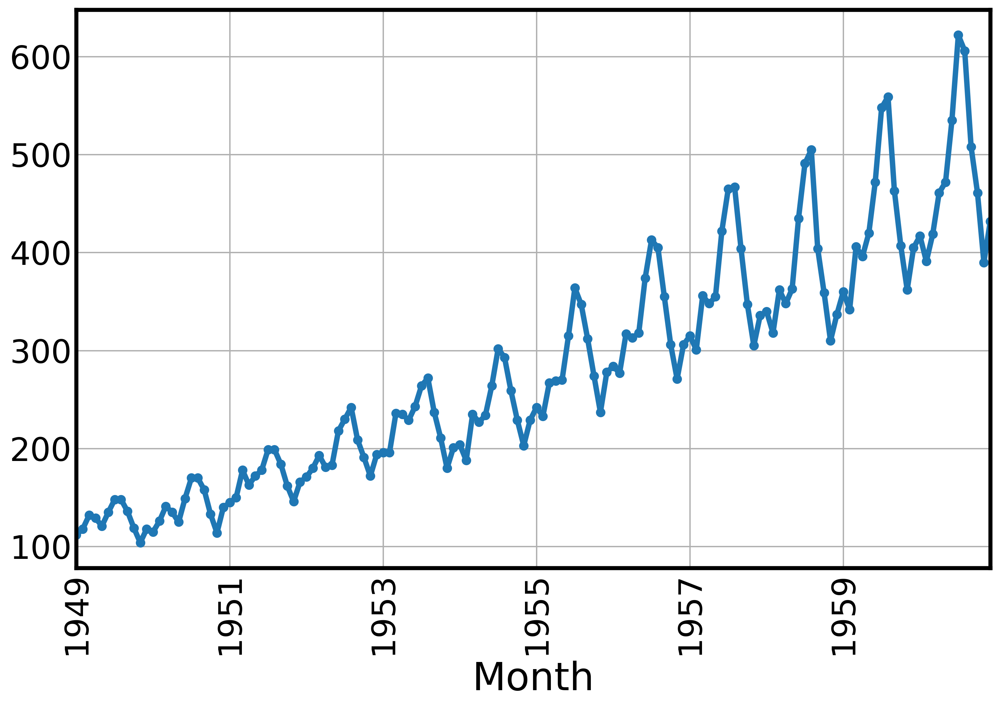

In [143]:
ax = airline.plot( legend=False,marker='o')
plt.xticks(rotation=90);

## Нормализованное преобразование

По-умолчанию, преобразование Бокса-Кокса приводит исходный ВР к нормальному распределению, насколько это возможно. Увидеть работу преобразования можно на гистограмме ряда или на q-q графике

In [144]:
from sktime.transformations.series.boxcox import BoxCoxTransformer

In [145]:
from sktime.transformations.series.boxcox import BoxCoxTransformer
transformer = BoxCoxTransformer()

airline_boxnorm = transformer.fit_transform(airline)

In [146]:
transformer.lambda_

0.14802265137037945

<Axes: xlabel='Month'>

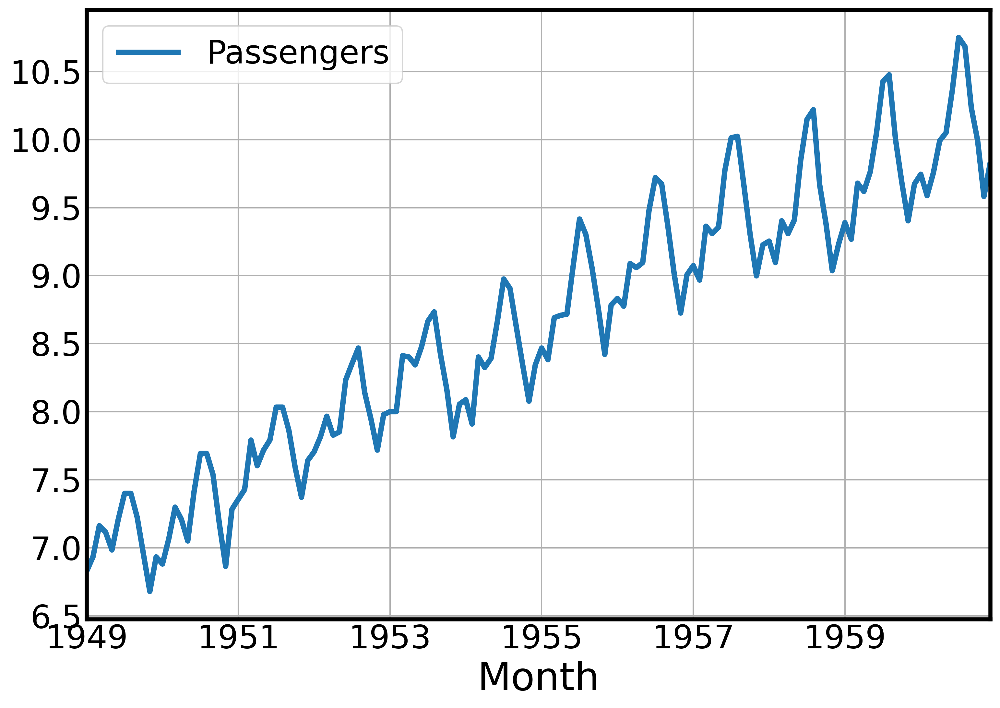

In [147]:
airline_boxnorm.plot()

<Axes: ylabel='Count'>

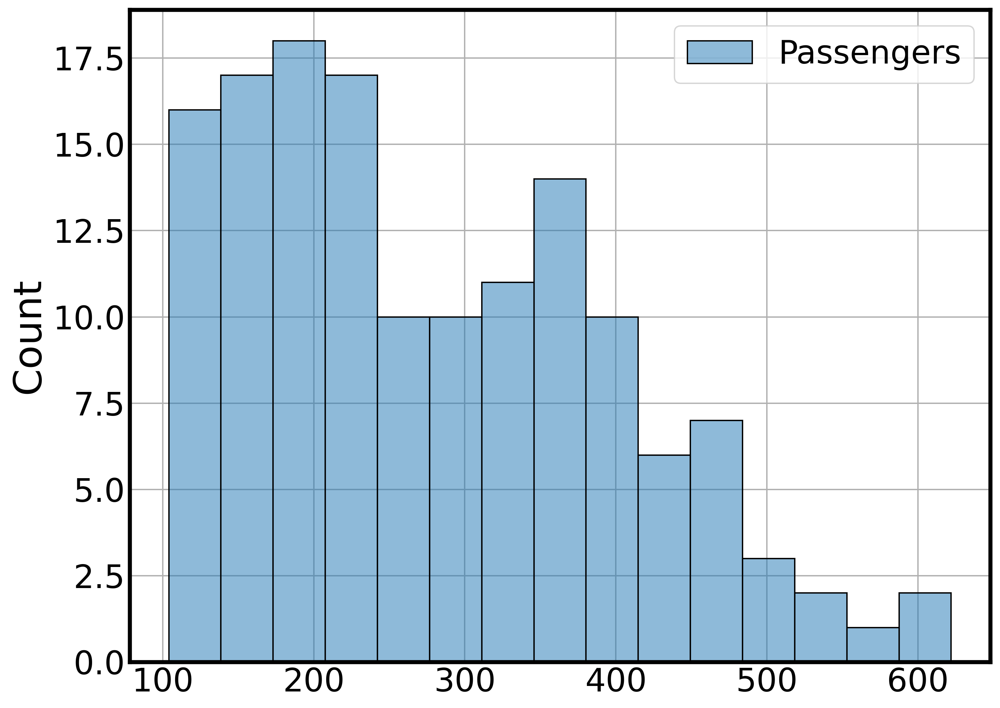

In [148]:
sns.histplot(airline,bins=15)

<Axes: ylabel='Count'>

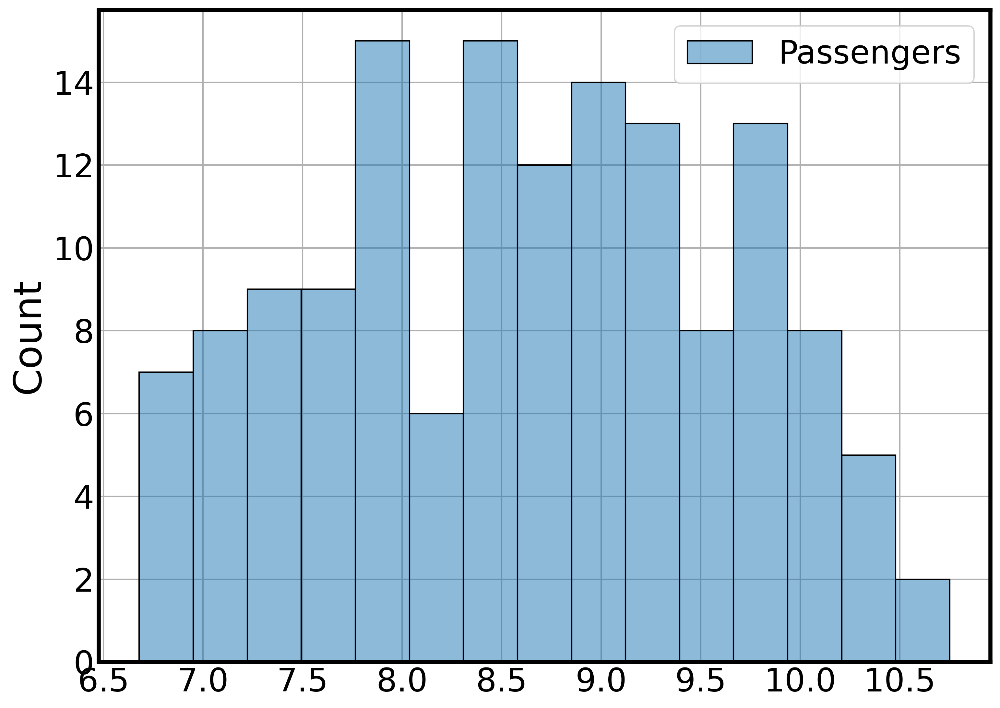

In [149]:
sns.histplot(airline_boxnorm,bins=15)

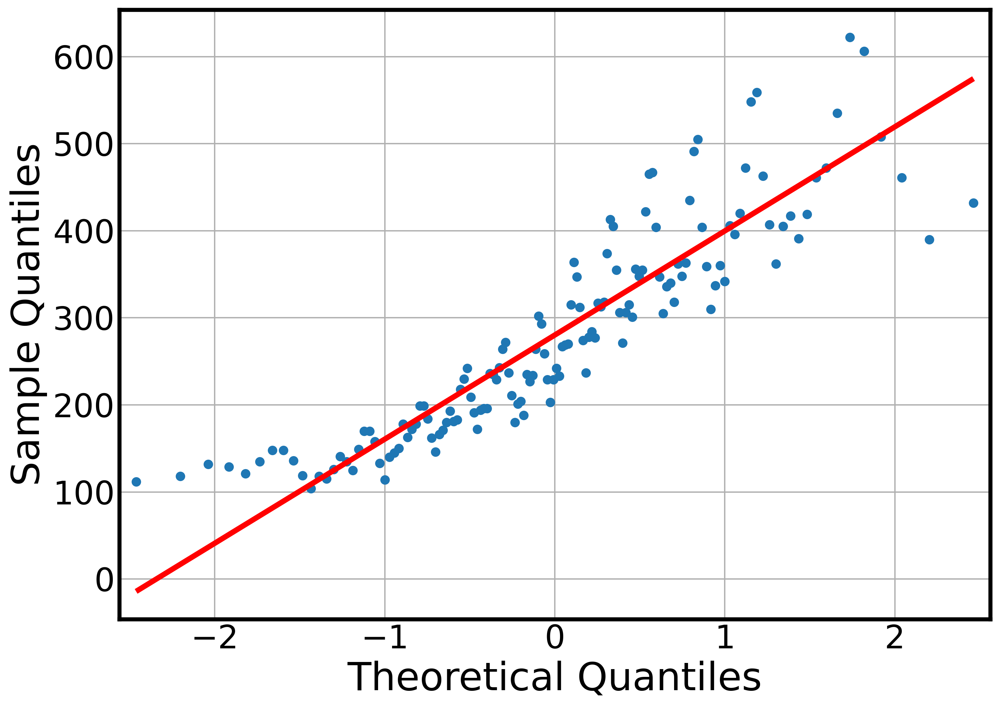

In [150]:
qqplot(airline,line='s');

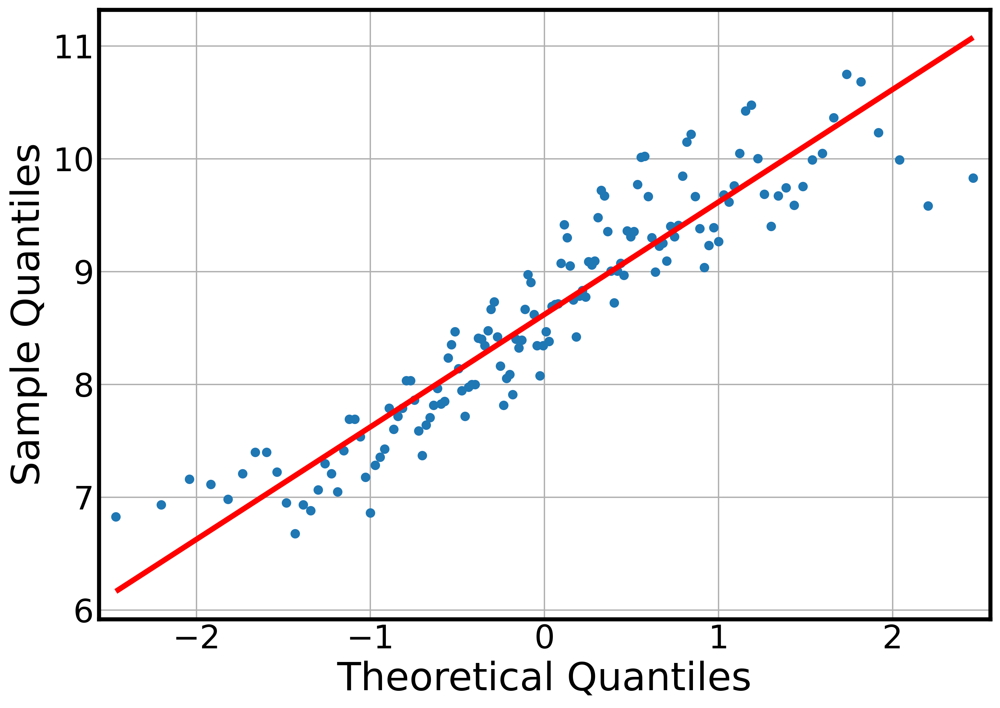

In [151]:
qqplot(airline_boxnorm,line='s');

## Сезонное преобразование

В статье  V.M. Guerrero, "Time-series analysis supported by Power Transformations ", Journal of Forecasting, vol. 12, pp. 37-48, 1993. был предложен подход к тому, чтобы сделать амплитуду сезонных колебаний вр однинаковой на всем его протяжении. Идея в том, чтобы подобрать такое $\lambda$, чтобы отношение стандартного отклонения вр к среднему в степени $1-\lambda$ было постоянным на всем вр

In [152]:
transformer = BoxCoxTransformer(method='guerrero',sp=12)

In [153]:
airline_boxses = transformer.fit_transform(airline)

In [154]:
transformer.lambda_

-0.2947236481659704

<Axes: xlabel='Month'>

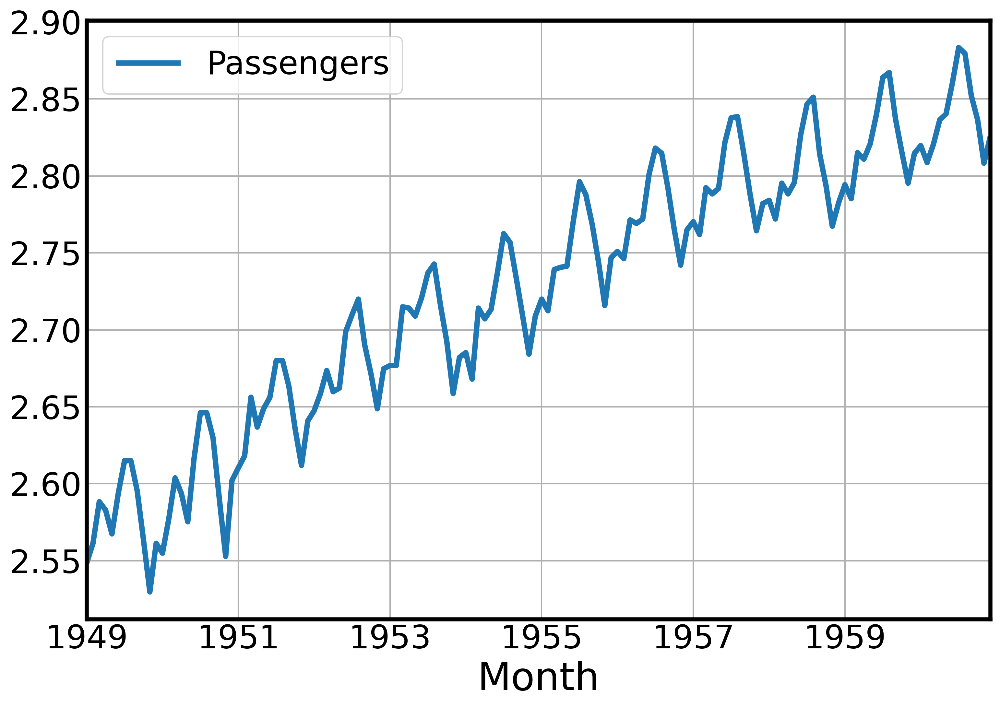

In [155]:
airline_boxses.plot()

Распределение здесь не стало ближе к нормальному, в отличии от стандартного преобразования Бокса-Кокса

<Axes: ylabel='Count'>

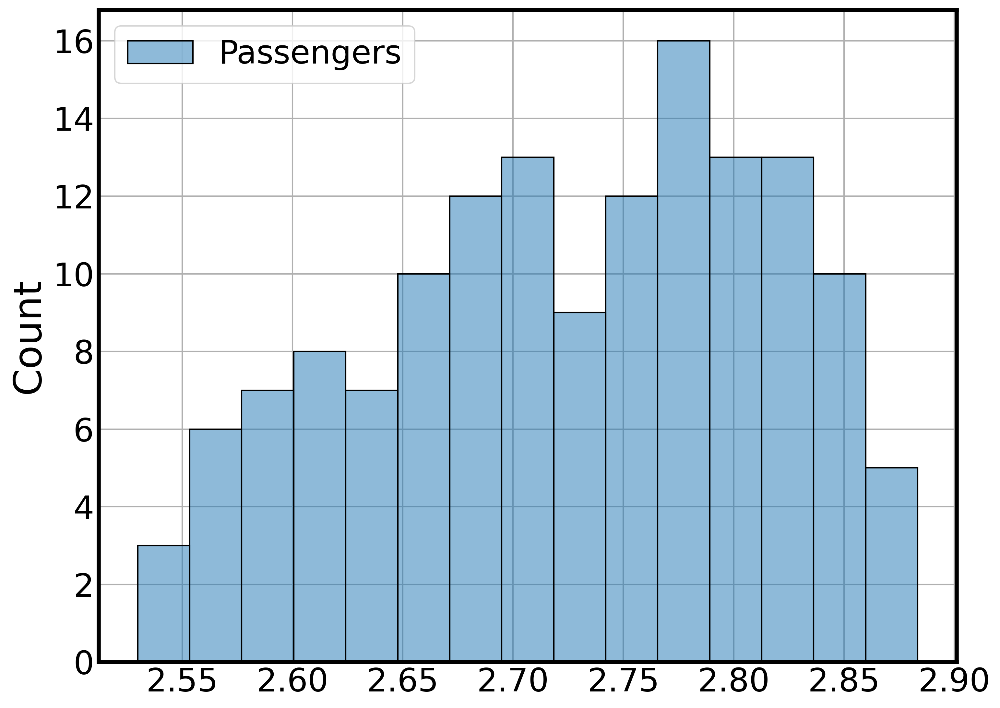

In [156]:
sns.histplot(airline_boxses,bins=15)

Проверим стабильность сезонных колебаний с помощью классической декомпозиции преобразованного вр. Если рост сезонных колебаний убрать не получилось, то мы увидим в остатках декомпозиции сезоннную компоненту

In [157]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [158]:
airline_addbox = seasonal_decompose(airline_boxses,
                                 model='additive',
                                 filt=None,
                                 period=12,
                                 two_sided=True,
                                 extrapolate_trend=0)

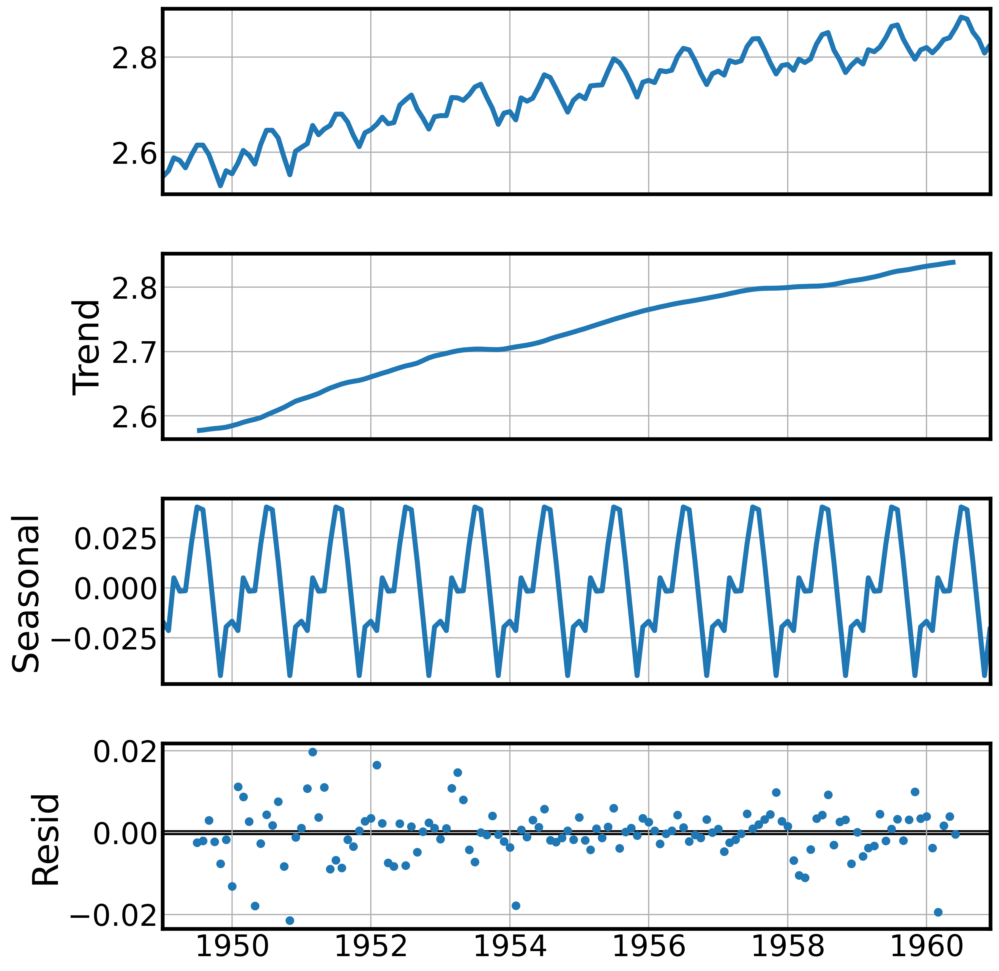

In [159]:
fig = airline_addbox.plot();
fig.set_size_inches((12,12))

Ярко выраженной сезонной компоненты в остатках нет

<Axes: xlabel='Month'>

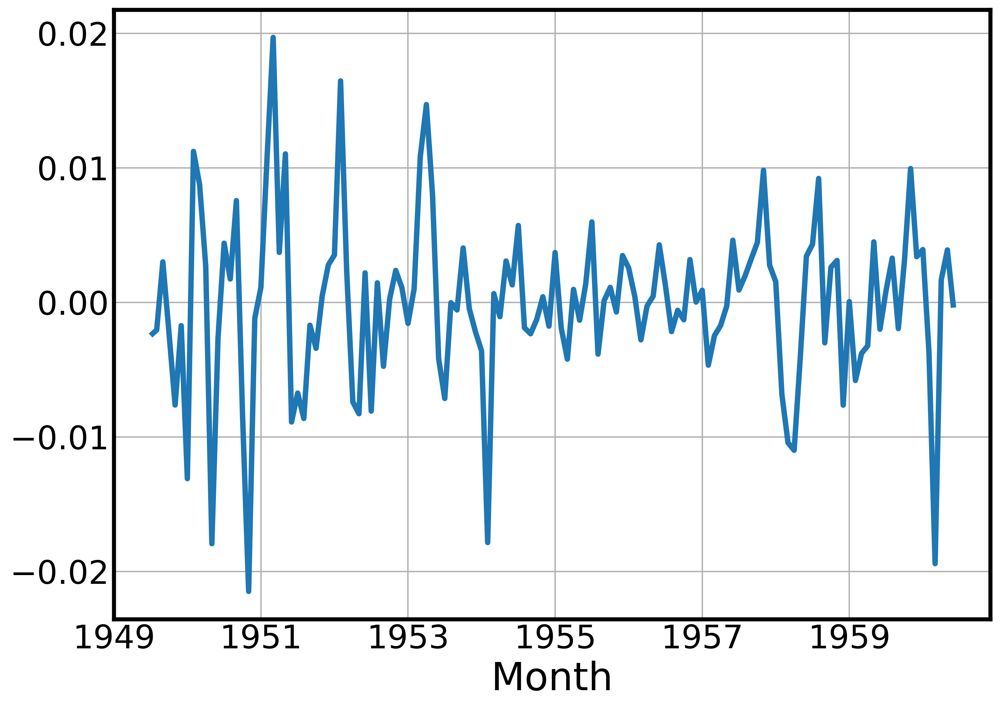

In [160]:
airline_addbox.resid.plot()

## Возникновения баейса после преобразования Бокса-Кокса

In [161]:
gdp = pd.read_csv("data/russia-gdp-gross-domestic-product.csv")
gdp['obs_num'] = gdp.reset_index()['index'] # переменная х для линейного тренда
gdp['date'] = pd.to_datetime(gdp['date'])
gdp.set_index('date',inplace=True) # задаем дату в качестве индекса
gdp['const'] = 1 # свободный член для линейного тренда

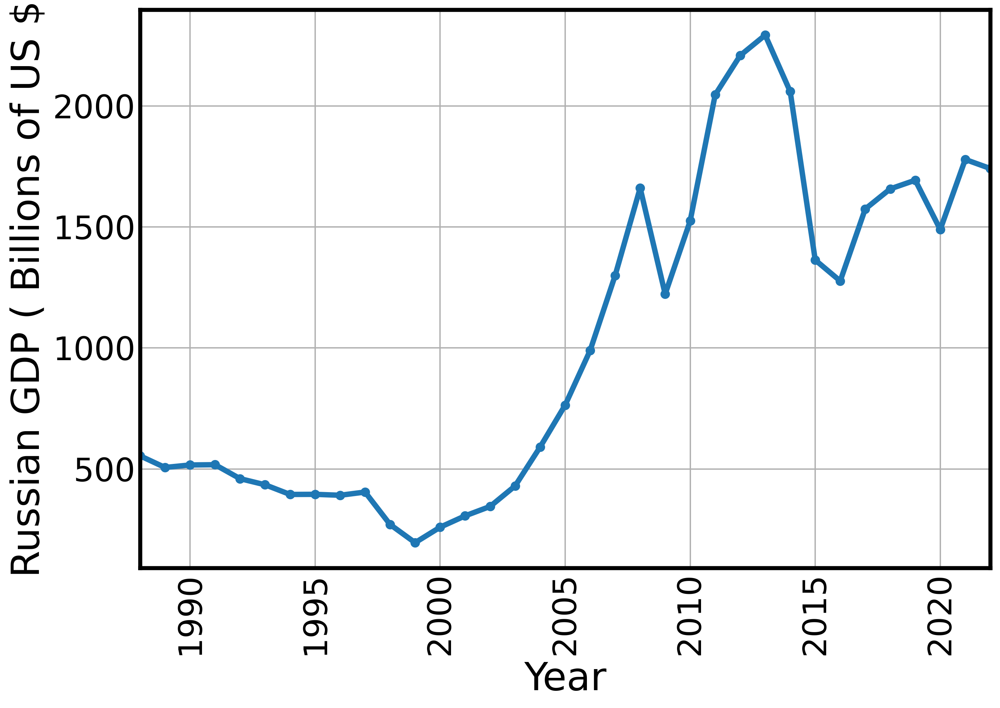

In [162]:
ax = gdp.plot(y=' GDP ( Billions of US $)', legend=False,marker='o')
ax.set_ylabel('Russian GDP ( Billions of US $')
ax.set_xlabel('Year')
plt.xticks(rotation=90);

корректировка баеса для преобразования бокса-кокса

In [163]:
def BC_inverse(y, lam, sig):
    """Back transform Box-Cox with Bias correction.
    See https://robjhyndman.com/hyndsight/backtransforming
    """
    if lam == 0:
        return np.exp(y) * (1 + 0.5 * sig**2)
    else:
        res = np.power(lam*y + 1., 1/lam)
        res *= (1 + 0.5 * sig**2 * (1 - lam) / (lam*y + 1.)**2)
        return res

Преобразуем вр с нелинейным трендом с помощью бокса-кокса, после чего уберем из него линейный тренд

In [164]:
transformer = BoxCoxTransformer()

gdp[' GDP ( Billions of US $) box'] = transformer.fit_transform(gdp[' GDP ( Billions of US $)'])

In [165]:
linear_trend_model = sm.OLS(gdp[' GDP ( Billions of US $)'],gdp[['obs_num','const']]).fit()
gdp['GDP TREND'] = linear_trend_model.predict(gdp[['obs_num','const']])

In [166]:
linear_trend_model = sm.OLS(gdp[' GDP ( Billions of US $) box'],gdp[['obs_num','const']]).fit()
gdp['GDP TREND BOX'] = linear_trend_model.predict(gdp[['obs_num','const']])

<Axes: xlabel='date'>

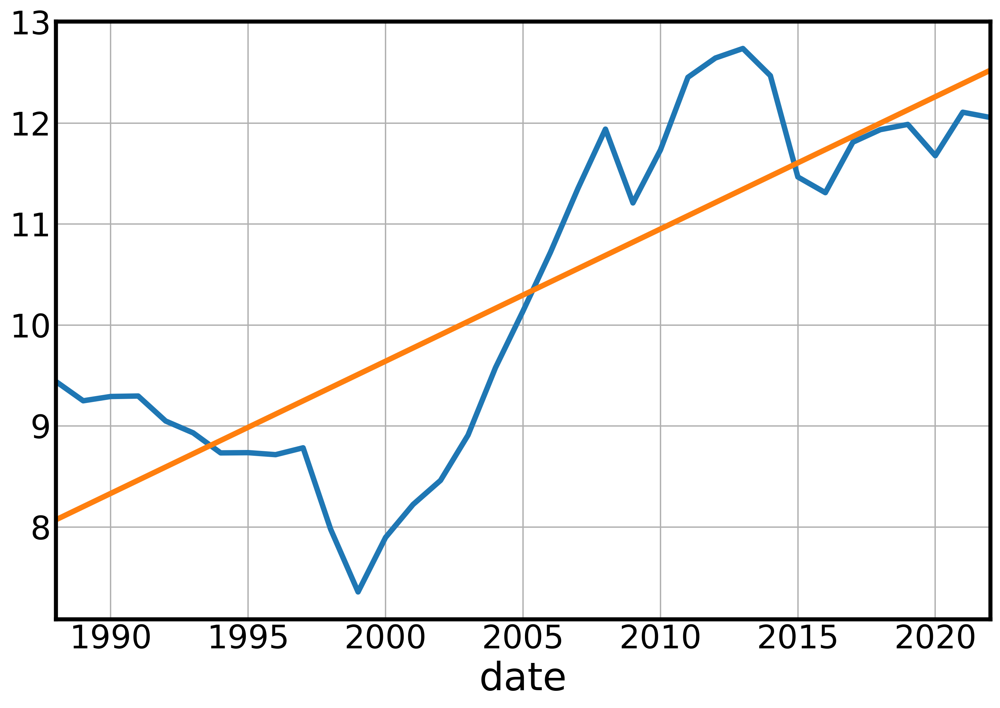

In [167]:
gdp[' GDP ( Billions of US $) box'].plot()
gdp['GDP TREND BOX'].plot()

Теперь вернемся к исходному вр и сравним ошибки для линейного тренда с помощью корректировки байеса из-за преобразования Бокса-Кокса и без нее.

In [168]:
gdp['GDP TREND DEBOX'] = transformer.inverse_transform(gdp['GDP TREND BOX'])

In [169]:
gdp['GDP TREND DEBOXc'] = BC_inverse(gdp['GDP TREND BOX'], 
                                     transformer.lambda_, 
                                    linear_trend_model.mse_resid)

<Axes: xlabel='date'>

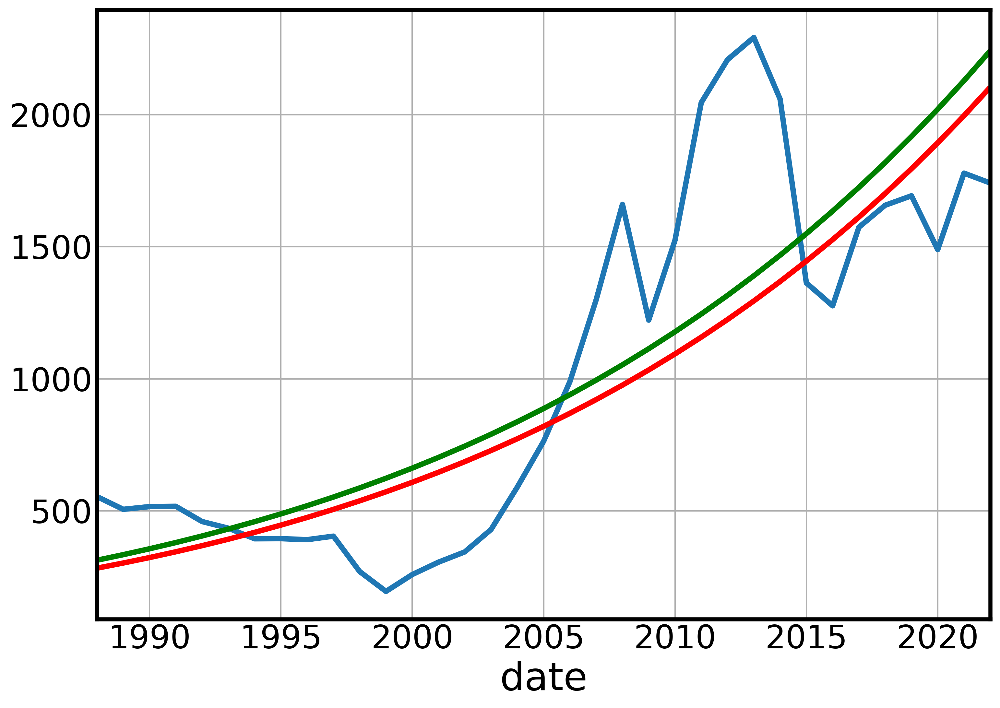

In [170]:
gdp[' GDP ( Billions of US $)'].plot()
gdp['GDP TREND DEBOX'].plot(c = 'red')
gdp['GDP TREND DEBOXc'].plot(c = 'green')
#gdp['GDP TREND'].plot()

визуально и остатки и сам тренд выглядят одинаково

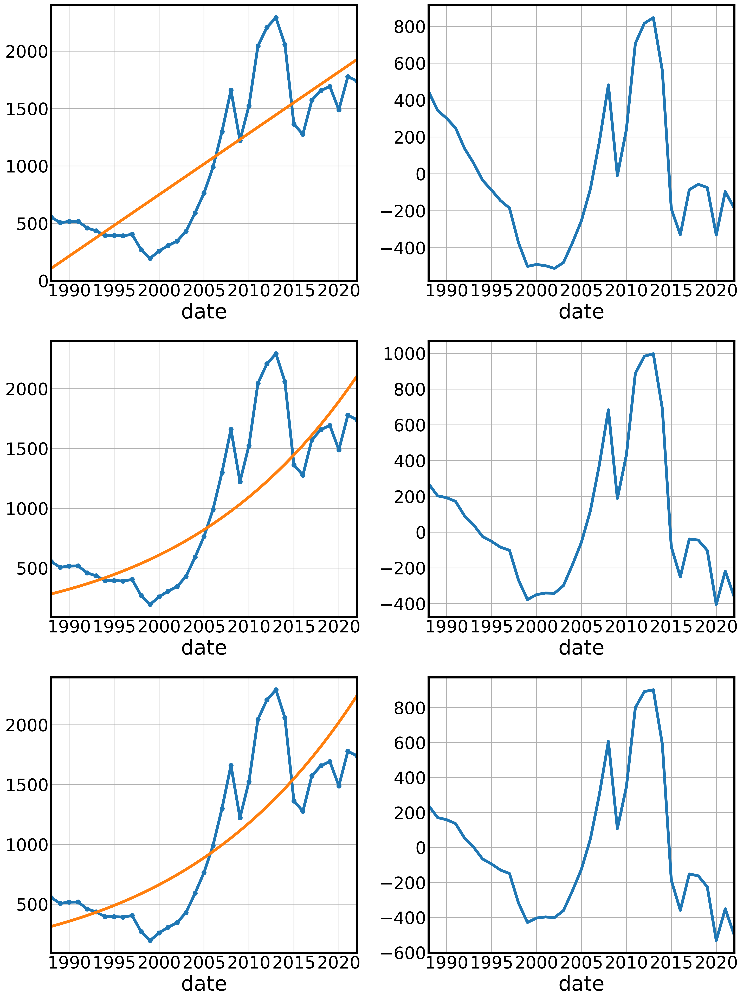

In [171]:
N_COLS = 2
trends_list = [gdp['GDP TREND'],
                gdp['GDP TREND DEBOX'],
               gdp['GDP TREND DEBOXc']]

fig,ax = plt.subplots(len(trends_list),N_COLS,figsize=(15,20))

for i,trend_est in enumerate(trends_list):
    gdp.plot(y=' GDP ( Billions of US $)', legend=False,marker='o',label='gdp',ax=ax[i][0])
    trend_est.plot(ax=ax[i][0])
    
    (gdp[' GDP ( Billions of US $)'] - trend_est).plot(ax=ax[i][1])


сравним ошибки

In [172]:
trends_list = [ gdp['GDP TREND DEBOX'],
               gdp['GDP TREND DEBOXc']]

In [173]:
from sklearn.metrics import mean_absolute_error, r2_score,mean_squared_error, mean_squared_log_error

In [174]:
metrics = [mean_absolute_error, r2_score,mean_squared_error, mean_squared_log_error]

In [175]:
cm = sns.light_palette("green", as_cmap=True,reverse=True,)
error_df = pd.DataFrame([[metr(gdp[tren.notna()][' GDP ( Billions of US $)'],
       tren[tren.notna()]) for metr in metrics] for tren in trends_list],
            index=[tren.name for tren in trends_list],
            columns=[metr.__name__ for metr in metrics])

error_df.style.background_gradient(cmap=cm)

,mean_absolute_error,r2_score,mean_squared_error,mean_squared_log_error
GDP TREND DEBOX,294.526157,0.644213,154411.752222,0.195150
GDP TREND DEBOXc,312.638408,0.653176,150521.934619,0.203045


Видно, что r2 и квадратичная ошибка лучше у скорректированного преобразования, а вот абсолютная ошибка - лучше без корректировки. Это не удивительно, т.к. суть корректировки - замена медианы прогнозов на среднее.